### Librerías

In [1]:
import pyodbc
import pandas as pd
import numpy as np
import os
import logging
from functools import reduce
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.api import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from itertools import product

### Conexión a Azure

In [2]:
import os
import logging
import pandas as pd
import pyodbc
from functools import reduce

# Configura logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

# Configuración de conexión
AZURE_SERVER = 'uaxmathfis.database.windows.net'
AZURE_DATABASE = 'usecases'
AZURE_DRIVER = '{ODBC Driver 17 for SQL Server}'
CSV_PATH = 'datos.csv'

def get_azure_connection():
    """Establece conexión con Azure SQL usando autenticación interactiva"""
    conn_str = f"DRIVER={AZURE_DRIVER};SERVER={AZURE_SERVER};DATABASE={AZURE_DATABASE};Authentication=ActiveDirectoryInteractive"
    try:
        conn = pyodbc.connect(conn_str)
        logging.info("Conexión exitosa a Azure SQL")
        return conn
    except Exception as e:
        logging.error(f"Error de conexión: {e}")
        return None

def download_and_combine_tables():
    """Descarga todas las tablas y las combina correctamente por ID"""
    if os.path.exists(CSV_PATH):
        try:
            os.remove(CSV_PATH)
            logging.info(f"Archivo existente {CSV_PATH} eliminado")
        except Exception as e:
            logging.error(f"No se pudo eliminar {CSV_PATH}: {e}")

    queries = {
        'IA_Client_Segment_MODIFICADO': "SELECT * FROM DATAEX.IA_Client_Segment_MODIFICADO"
    }

    conn = get_azure_connection()
    if not conn:
        return pd.DataFrame()

    try:
        dfs = {}
        for name, query in queries.items():
            try:
                df = pd.read_sql(query, conn)
                logging.info(f"Tabla {name} descargada con {len(df)} registros")

                if 'ID' not in df.columns:
                    logging.warning(f"La tabla {name} no contiene columna 'ID'")
                    continue

                df['ID'] = df['ID'].astype(str)
                df = df.dropna(subset=['ID'])
                df = df.drop_duplicates(subset=['ID'])

                dfs[name] = df.set_index('ID')

            except Exception as e:
                logging.error(f"Error procesando {name}: {e}")

        if dfs:
            combined = reduce(lambda left, right: pd.merge(left, right, left_index=True, right_index=True, how='outer'), dfs.values())
            combined.to_csv(CSV_PATH)
            logging.info(f"Nuevo archivo {CSV_PATH} creado con {len(combined)} registros combinados")
            return combined
        else:
            logging.warning("No se descargaron datos válidos")
            return pd.DataFrame()

    finally:
        conn.close()

def load_from_csv():
    """Carga los datos previamente guardados desde el CSV"""
    try:
        if os.path.exists(CSV_PATH):
            return pd.read_csv(CSV_PATH, index_col='ID')
        else:
            logging.warning(f"Archivo {CSV_PATH} no encontrado")
            return pd.DataFrame()
    except Exception as e:
        logging.error(f"Error cargando CSV: {e}")
        return pd.DataFrame()

# Ejecutar la descarga
# df = download_and_combine_tables()

# Alternativamente, para cargar desde el CSV si ya existe:
df = load_from_csv()

if not df.empty:
    print("\nDatos combinados correctamente:")
    print(f"Total de registros: {len(df)}")
    print(f"Columnas: {len(df.columns)}")
    print(df.head())
else:
    print("No hay datos disponibles")


Datos combinados correctamente:
Total de registros: 10806
Columnas: 17
         Genero Casado  Edad Graduado    Profesion Experiencia_laboral  \
ID                                                                       
CLI10         F     Si    67       Si    Ingeniero            +20annos   
CLI100        M     Si    64       Si       Medico            +20annos   
CLI1000       M     Si    65       Si      Artista            +20annos   
CLI10000      M     No    33       No  Funcionario          10-20annos   
CLI10001      M     Si    52       No        Otros            +20annos   

         Gastoscore  Family_Size  anno_nacimiento    Generacion  \
ID                                                                
CLI10          Bajo            3             1957  Generacion X   
CLI100        Medio            2             1960  Generacion X   
CLI1000       Medio            3             1959  Generacion X   
CLI10000       Bajo            4             1991   Millennials   
CLI1000

### Datos

In [3]:
df

,Genero,Casado,Edad,Graduado,Profesion,Experiencia_laboral,Gastoscore,Family_Size,anno_nacimiento,Generacion,Ingresos_anuales_brutos,Provincia,Digital_encuesta,Gasto_medio_mensual_cuota,Abandono,Dias_cliente,Campanna_anno
ID,,,,,,,,,,,,,,,,,
CLI10,F,Si,67,Si,Ingeniero,+20annos,Bajo,3,1957,Generacion X,93442,Segovia,1385.0,80,True,195,NaN
CLI100,M,Si,64,Si,Medico,+20annos,Medio,2,1960,Generacion X,99774,Alicante,1052.0,50,True,360,5.0
CLI1000,M,Si,65,Si,Artista,+20annos,Medio,3,1959,Generacion X,36756,Toledo,1717.0,30,False,407,3.0
CLI10000,M,No,33,No,Funcionario,10-20annos,Bajo,4,1991,Millennials,24616,Leon,1606.0,30,False,544,4.0
CLI10001,M,Si,52,No,Otros,+20annos,Medio,2,1972,Generacion X,29834,LLeida,1346.0,30,True,170,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CLI9995,F,Si,76,No,Servicios,+20annos,Alto,2,1948,Generacion X,33389,Toledo,1424.0,30,True,106,NaN
CLI9996,F,No,44,Si,Funcionario,+20annos,Bajo,1,1980,Generacion X,76067,Cordoba,1514.0,50,False,257,NaN
CLI9997,M,Si,47,Si,Ejecutivo,+20annos,Alto,3,1977,Generacion X,61300,Lugo,1385.0,80,True,347,5.0


## Preprocesamiento

### Zonas geográficas

In [4]:
# Diccionario para reemplazar nombres mal codificados
reemplazos = {
    'ivila': 'Ávila',
    'ilava': 'Álava',
    'Guipiºzcoa': 'Guipúzcoa',
    'Almeri­a': 'Almería',
    'La Corui±a': 'La Coruña',
    'LLeida': 'Lleida'
}

# Aplicar reemplazo en la columna Provincia
df['Provincia'] = df['Provincia'].replace(reemplazos)

norte = ['La Coruña', 'Lugo', 'Orense', 'Pontevedra', 'Vizcaya', 'Guipúzcoa', 'Álava', 'Navarra', 'La Rioja', 'Burgos', 'Soria', 'Leon', 'Huesca']
sur = ['Almería', 'Cádiz', 'Córdoba', 'Granada', 'Huelva', 'Jaen', 'Málaga', 'Sevilla', 'Ceuta', 'Melilla']
este = ['Barcelona', 'Gerona', 'Lleida', 'Tarragona', 'Castellon', 'Valencia', 'Alicante', 'Murcia', 'Baleares']
oeste = ['Caceres', 'Badajoz', 'Salamanca', 'Zamora']
centro = ['Madrid', 'Guadalajara', 'Toledo', 'Cuenca', 'Ciudad Real', 'Ávila', 'Segovia', 'Valladolid', 'Palencia']
islas = ['Las Palmas', 'Santa Cruz de Tenerife']

def asignar_region(provincia):
    if provincia in norte:
        return 'Norte'
    elif provincia in sur:
        return 'Sur'
    elif provincia in este:
        return 'Este'
    elif provincia in oeste:
        return 'Oeste'
    elif provincia in centro:
        return 'Centro'
    elif provincia in islas:
        return 'Islas'
    else:
        return 'Desconocido'

df['Region'] = df['Provincia'].apply(asignar_region)

### Transformación a numéricas

In [5]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder

# 1. Binarias
bin_map = {
    'Genero': {'F': 0, 'M': 1},
    'Casado': {'No': 0, 'Si': 1},
    'Graduado': {'No': 0, 'Si': 1},
    'Abandono': {False: 0, True: 1}
}
for col, mapping in bin_map.items():
    df[col] = df[col].map(mapping)

# 2. Ordinales con orden definido
df['Experiencia_laboral'] = df['Experiencia_laboral'].map({
    '<10annos': 0, '10-20annos': 1, '+20annos': 2
})

df['Gastoscore'] = df['Gastoscore'].map({
    'Bajo': 0, 'Medio': 1, 'Alto': 2
})

df['Generacion'] = df['Generacion'].map({
    'Generacion Silenciosa':0, 'Baby Boomers': 1, 'Generacion X': 2, 'Millennials': 3, 'Generacion Z': 4
})

df['Campanna_anno'] = pd.to_numeric(df['Campanna_anno'], errors='coerce')

# 3. Nominales sin orden
le_dict = {}
for col in ['Profesion', 'Provincia']:
    df[col] = df[col].astype(str).str.strip()
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    le_dict[col] = dict(zip(le.classes_, le.transform(le.classes_)))

# 4. Forzar columnas numéricas
num_cols = ['Edad', 'Family_Size', 'anno_nacimiento',
            'Ingresos_anuales_brutos', 'Digital_encuesta',
            'Gasto_medio_mensual_cuota', 'Dias_cliente']
for col in num_cols:
    df[col] = pd.to_numeric(df[col], errors='coerce')

# Codificar la columna 'Region' como nominal sin orden
le_region = LabelEncoder()
df['Region'] = df['Region'].astype(str).str.strip()
df['Region'] = le_region.fit_transform(df['Region'])

# 5. Mostrar valores faltantes
print("\nValores faltantes por columna:")
print(df.isna().sum()[df.isna().sum() > 0])


Valores faltantes por columna:
Casado            190
Graduado          103
Campanna_anno    5707
dtype: int64


### Rellenar valores faltantes

In [6]:
import pandas as pd
from sklearn.impute import SimpleImputer

# 1. Casado y Graduado → Imputar con la moda
imputer_mode = SimpleImputer(strategy='most_frequent')
df[['Casado', 'Graduado']] = imputer_mode.fit_transform(df[['Casado', 'Graduado']])

# 2. Generacion → Calcular a partir del año de nacimiento
def generar_generacion(anio):
    if anio >= 1997:
        return 4  # Gen Z
    elif anio >= 1981:
        return 3  # Millennials
    elif anio >= 1965:
        return 2  # Gen X
    elif anio >= 1946:
        return 1  # Baby Boomers
    elif anio <= 1945:
        return 0 # Generacion Silenciosa
    else:
        return -1  # Silent Gen

df['Generacion'] = df.apply(
    lambda row: row['Generacion'] if pd.notna(row['Generacion']) else generar_generacion(row['anno_nacimiento']),
    axis=1
)

# 3. Campanna_anno → Imputar con -1 (representa valor faltante de forma explícita)
df['Campanna_anno'] = df['Campanna_anno'].fillna(-1)

In [7]:
# 5. Mostrar valores faltantes
print("\nValores faltantes por columna:")
print(df.isna().sum()[df.isna().sum() > 0])


Valores faltantes por columna:
Series([], dtype: int64)


### Datos procesados

In [8]:
df

,Genero,Casado,Edad,Graduado,Profesion,Experiencia_laboral,Gastoscore,Family_Size,anno_nacimiento,Generacion,Ingresos_anuales_brutos,Provincia,Digital_encuesta,Gasto_medio_mensual_cuota,Abandono,Dias_cliente,Campanna_anno,Region
ID,,,,,,,,,,,,,,,,,,
CLI10,0,1.0,67,1.0,4,2,0,3,1957,2.0,93442,37,1385.0,80,1,195,-1.0,0
CLI100,1,1.0,64,1.0,5,2,1,2,1960,2.0,99774,1,1052.0,50,1,360,5.0,2
CLI1000,1,1.0,65,1.0,0,2,1,3,1959,2.0,36756,42,1717.0,30,0,407,3.0,0
CLI10000,1,0.0,33,0.0,3,1,0,4,1991,3.0,24616,24,1606.0,30,0,544,4.0,4
CLI10001,1,1.0,52,0.0,7,2,1,2,1972,2.0,29834,25,1346.0,30,1,170,-1.0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CLI9995,0,1.0,76,0.0,8,2,2,2,1948,2.0,33389,42,1424.0,30,1,106,-1.0,0
CLI9996,0,0.0,44,1.0,3,2,0,1,1980,2.0,76067,12,1514.0,50,0,257,-1.0,1
CLI9997,1,1.0,47,1.0,2,2,2,3,1977,2.0,61300,26,1385.0,80,1,347,5.0,4


### Clasificación de columnas según tipo de transformación

**1. Variables Binarias (se convierten a 0 y 1)**

| Columna    | Valor 0 | Valor 1 |
|------------|---------|---------|
| Genero     | F       | M       |
| Casado     | No      | Si      |
| Graduado   | No      | Si      |
| Abandono   | False   | True    |



**2. Variables Ordinales (ordenadas de menor a mayor)**


a. Experiencia Laboral


| Valor Original | Codificado |
|----------------|------------|
| <10annos       | 0          |
| 10-20annos     | 1          |
| +20annos       | 2          |

b. Gastoscore


| Valor Original | Codificado |
|----------------|------------|
| Bajo           | 0          |
| Medio          | 1          |
| Alto           | 2          |

c. Generación


| Valor Original     | Codificado |
|--------------------|------------|
| Gen Silenciosa     | 0          |
| Baby Boomers       | 1          |
| Generacion X       | 2          |
| Millennials        | 3          |
| Generacion Z       | 4          |

d. Campanna_anno
- Se convierte directamente a número (`float`) para conservar orden.


**3. Variables Categóricas Nominales (sin orden)**

Estas se convierten con **Label Encoding**, el orden **no importa**.  
Guarda el diccionario generado para comprobarlo.

- **Provincia**
- **Profesion**

*Ejemplo de cómo imprimir equivalencias:*

```python
pd.Series(le_dict['Provincia'])  # para ver las provincias y su código
pd.Series(le_dict['Profesion'])  # para ver profesiones y su código


## PCA y Kmeans

### Flags

In [9]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": True,
    "Graduado": True,
    "Profesion": True,
    "Experiencia_laboral": True,
    "Gastoscore": True,
    "Family_Size": True,
    "anno_nacimiento": True,
    "Generacion": True,
    "Ingresos_anuales_brutos": True,
    "Provincia": True,
    "Digital_encuesta": True,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": True
}


# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]

### PCA y Kmeans con todas


Variables continuas seleccionadas para PCA: ['Edad', 'Profesion', 'Experiencia_laboral', 'Gastoscore', 'Family_Size', 'anno_nacimiento', 'Generacion', 'Ingresos_anuales_brutos', 'Provincia', 'Digital_encuesta', 'Gasto_medio_mensual_cuota', 'Dias_cliente', 'Campanna_anno']

Datos estandarizados:
       Edad  Profesion  Experiencia_laboral  Gastoscore  Family_Size  \
0  1.035176   0.268026             0.775758   -0.731429     0.152186   
1  0.872409   0.623398             0.775758    0.621270    -0.493738   
2  0.926665  -1.153465             0.775758    0.621270     0.152186   
3 -0.809517  -0.087347            -0.470020   -0.731429     0.798110   
4  0.221341   1.334144             0.775758    0.621270    -0.493738   

   anno_nacimiento  Generacion  Ingresos_anuales_brutos  Provincia  \
0        -1.034957   -0.432755                 1.052800   0.858601   
1        -0.872187   -0.432755                 1.231385  -1.643249   
2        -0.926444   -0.432755                -0.545951   1.

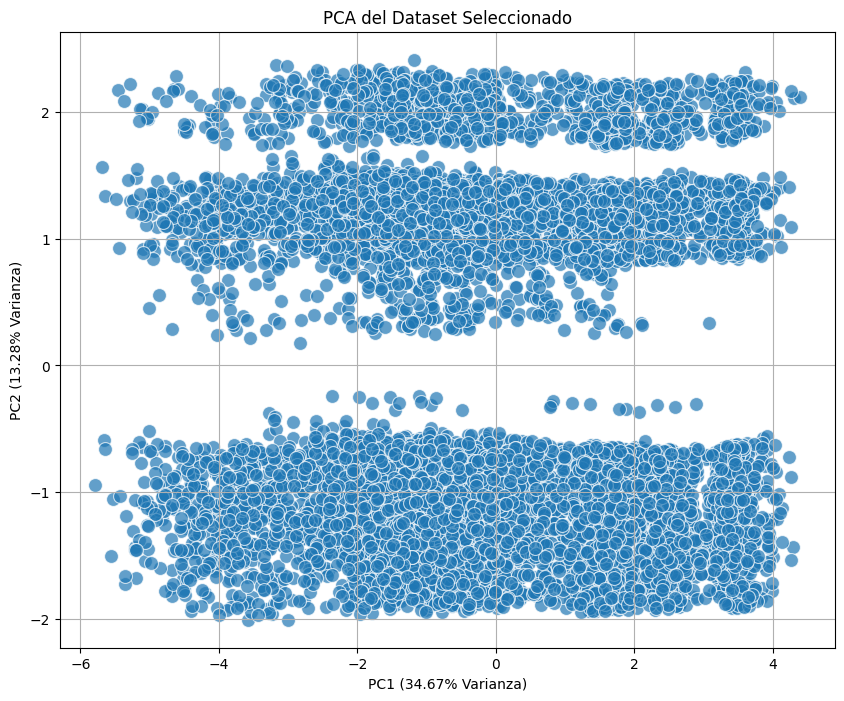

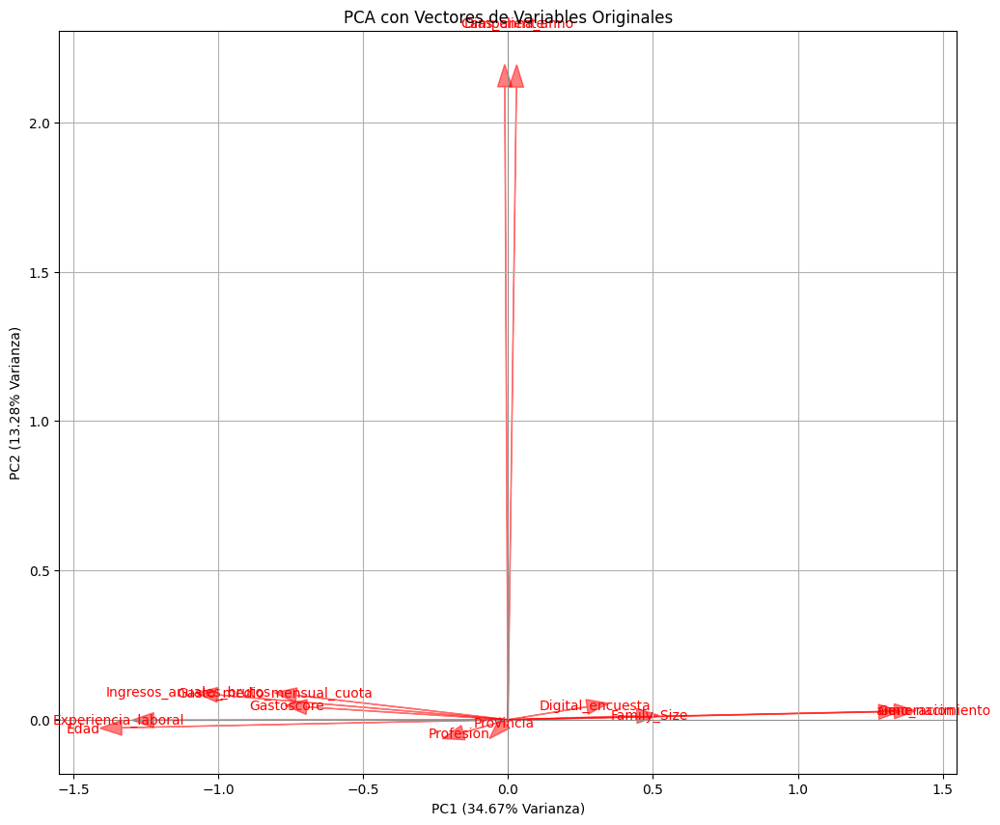


Cargas de las variables en las componentes principales:
                                PC1       PC2
Edad                      -0.444266 -0.009018
Profesion                 -0.051466 -0.014444
Experiencia_laboral       -0.407477 -0.000549
Gastoscore                -0.231512  0.014214
Family_Size                0.148185  0.004265
anno_nacimiento            0.444319  0.009434
Generacion                 0.426399  0.008799
Ingresos_anuales_brutos   -0.333867  0.027737
Provincia                 -0.003600 -0.003560
Digital_encuesta           0.090955  0.014341
Gasto_medio_mensual_cuota -0.243494  0.027227
Dias_cliente              -0.003597  0.706439
Campanna_anno              0.009709  0.706072


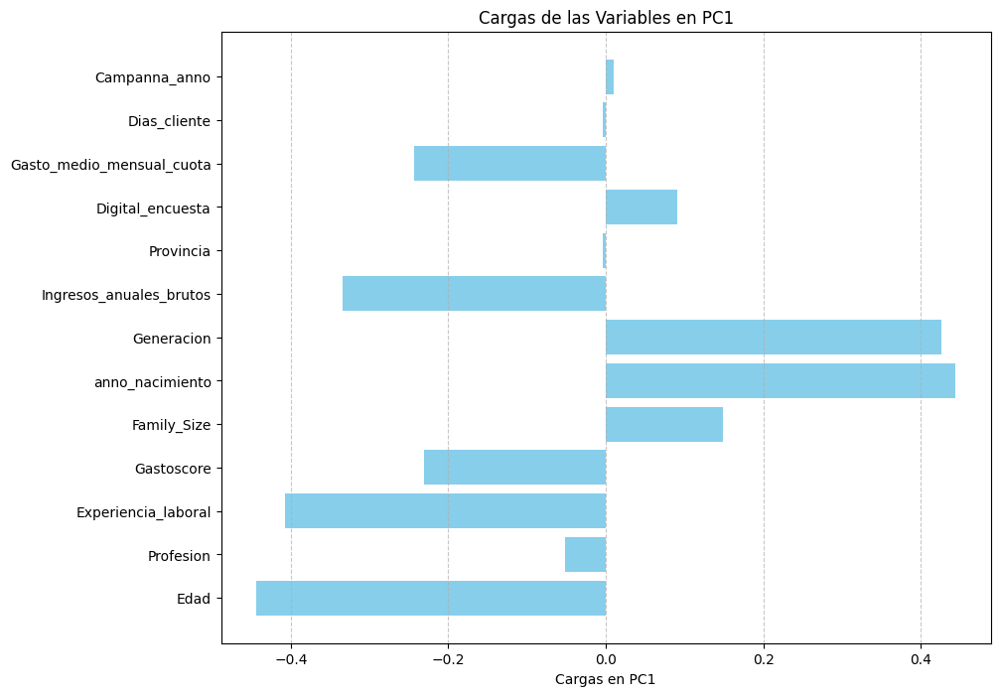

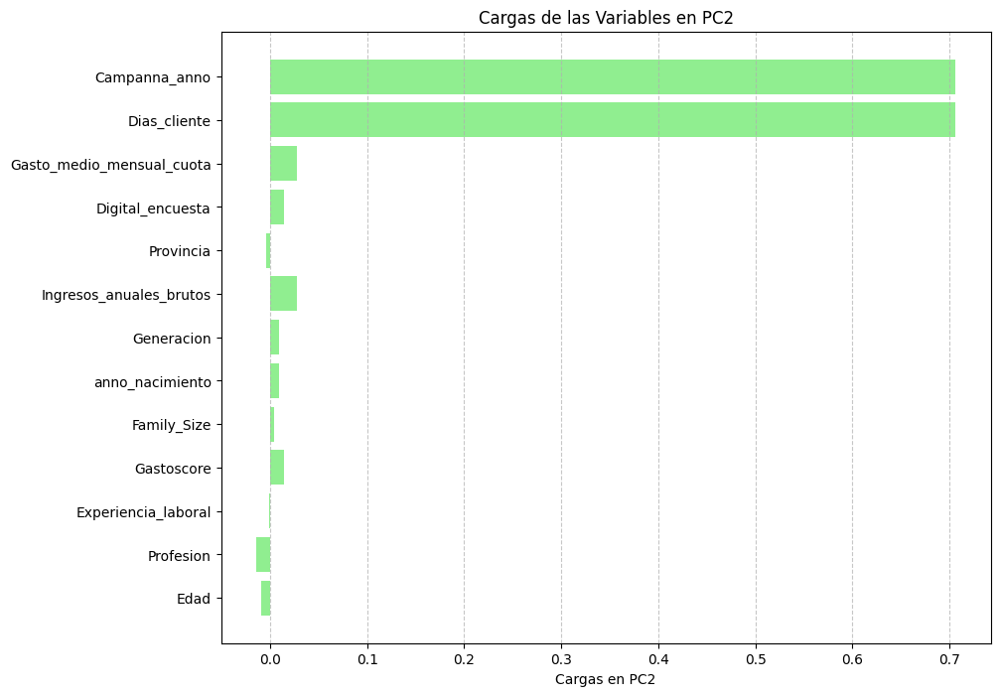

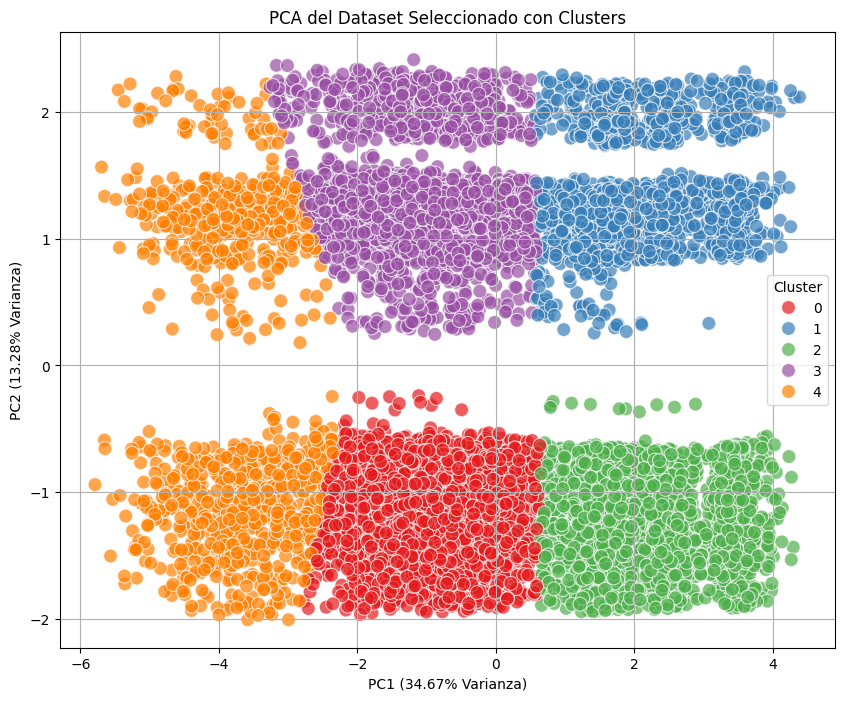

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

### Flags2

In [11]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": True,
    "Graduado": True,
    "Profesion": True,
    "Experiencia_laboral": True,
    "Gastoscore": True,
    "Family_Size": True,
    "anno_nacimiento": True,
    "Generacion": True,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": True,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": True
}


# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]

### PCA y Kmeans con todas


Variables continuas seleccionadas para PCA: ['Edad', 'Profesion', 'Experiencia_laboral', 'Gastoscore', 'Family_Size', 'anno_nacimiento', 'Generacion', 'Ingresos_anuales_brutos', 'Digital_encuesta', 'Gasto_medio_mensual_cuota', 'Dias_cliente', 'Campanna_anno']

Datos estandarizados:
       Edad  Profesion  Experiencia_laboral  Gastoscore  Family_Size  \
0  1.035176   0.268026             0.775758   -0.731429     0.152186   
1  0.872409   0.623398             0.775758    0.621270    -0.493738   
2  0.926665  -1.153465             0.775758    0.621270     0.152186   
3 -0.809517  -0.087347            -0.470020   -0.731429     0.798110   
4  0.221341   1.334144             0.775758    0.621270    -0.493738   

   anno_nacimiento  Generacion  Ingresos_anuales_brutos  Digital_encuesta  \
0        -1.034957   -0.432755                 1.052800         -0.099417   
1        -0.872187   -0.432755                 1.231385         -0.255354   
2        -0.926444   -0.432755                -0.545

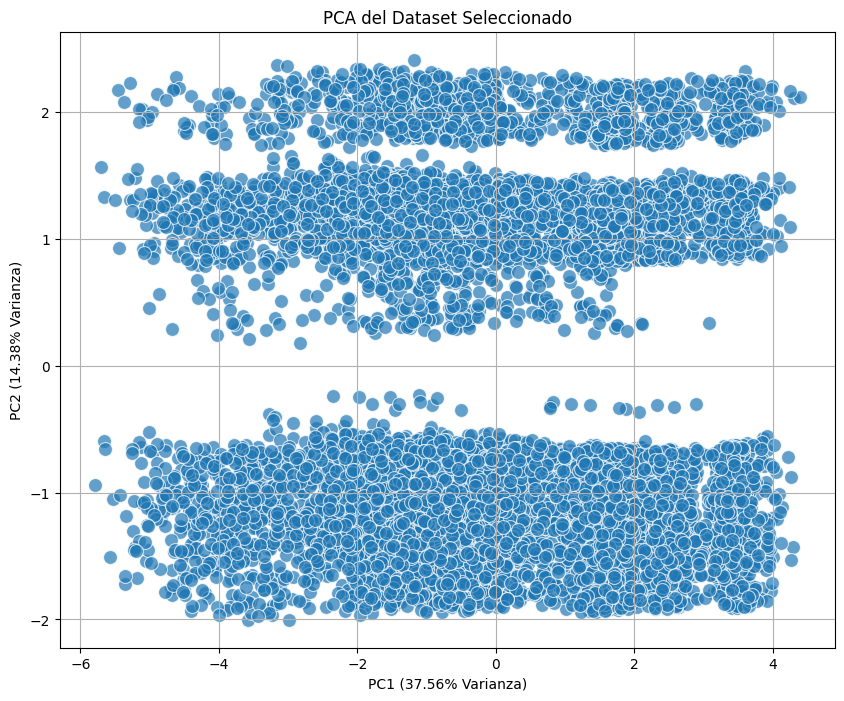

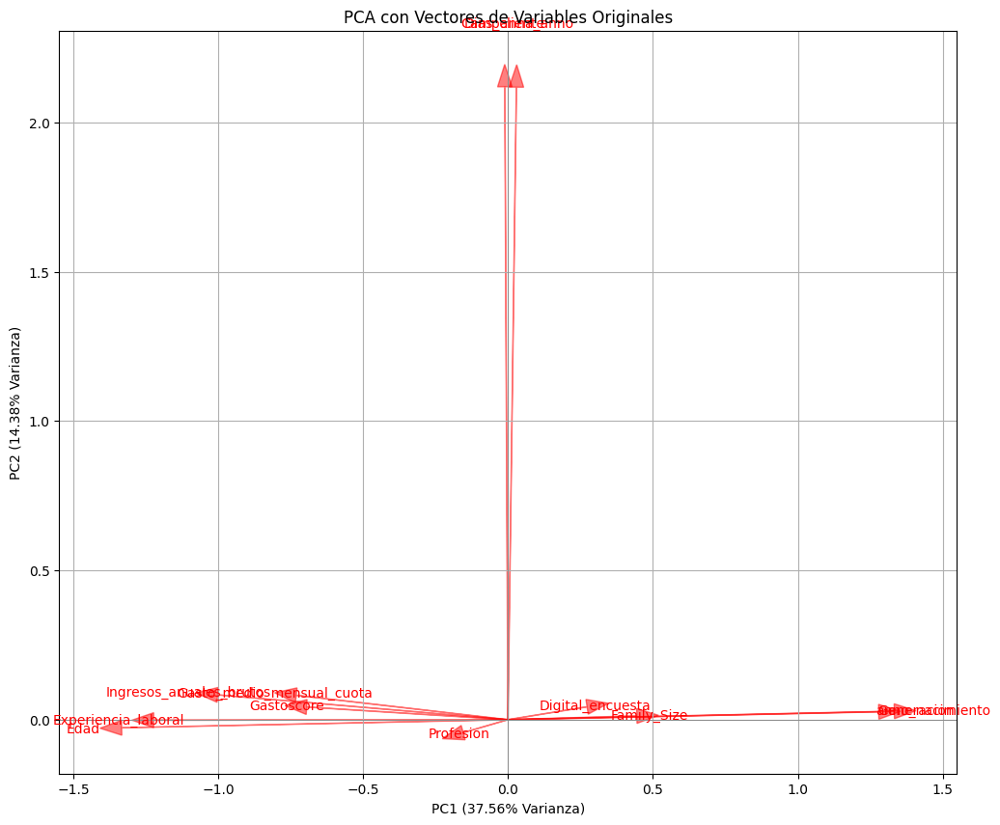


Cargas de las variables en las componentes principales:
                                PC1       PC2
Edad                      -0.444268 -0.009022
Profesion                 -0.051470 -0.014458
Experiencia_laboral       -0.407475 -0.000540
Gastoscore                -0.231524  0.014155
Family_Size                0.148170  0.004186
anno_nacimiento            0.444321  0.009438
Generacion                 0.426403  0.008809
Ingresos_anuales_brutos   -0.333873  0.027719
Digital_encuesta           0.090960  0.014362
Gasto_medio_mensual_cuota -0.243496  0.027220
Dias_cliente              -0.003597  0.706452
Campanna_anno              0.009705  0.706070


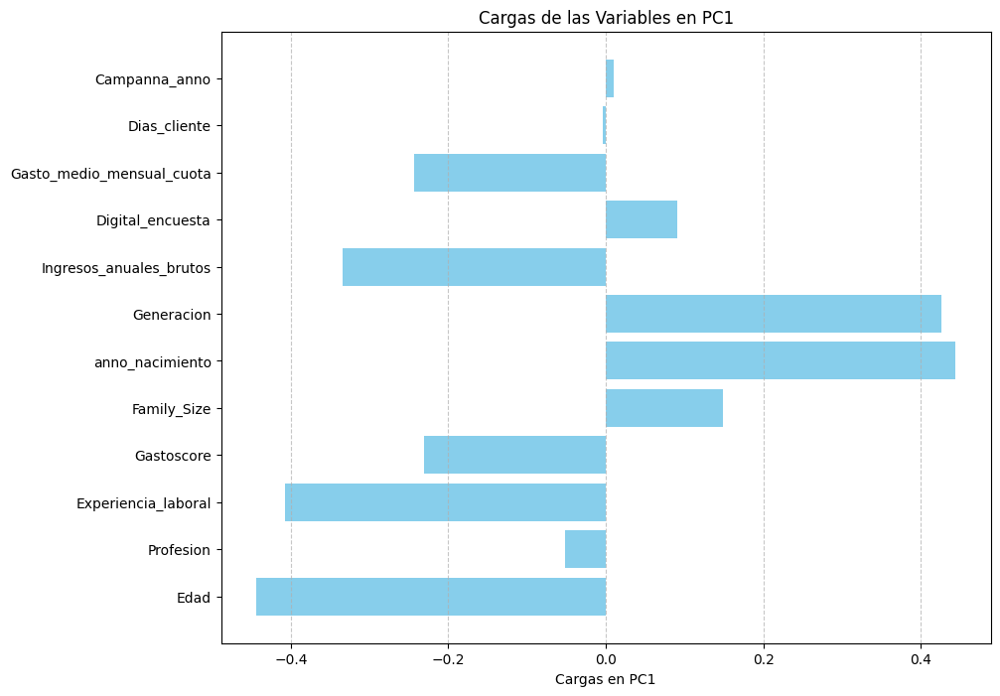

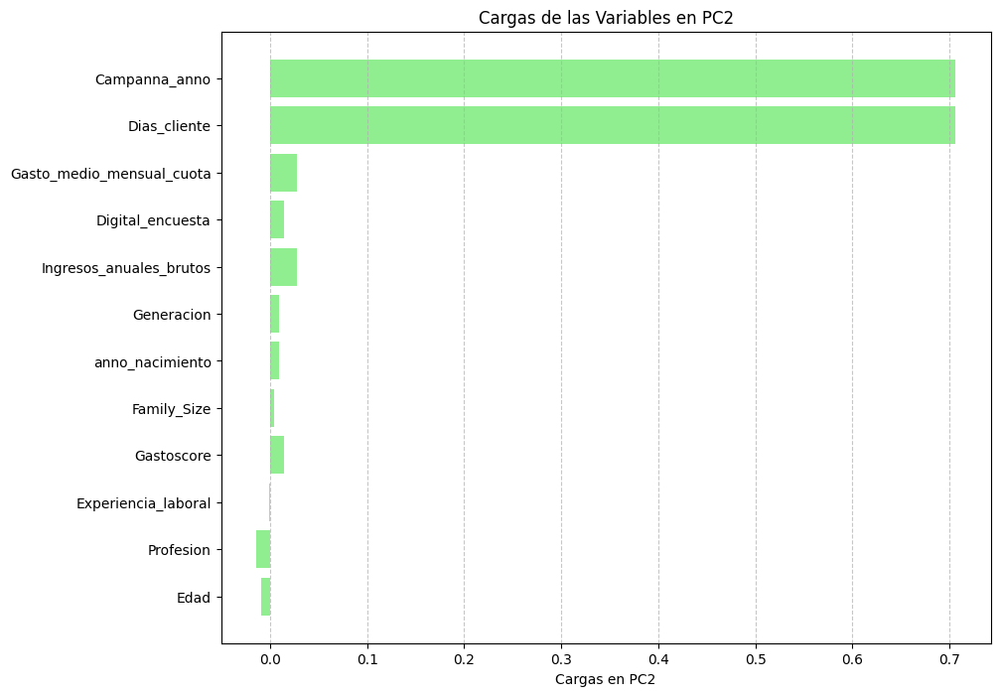

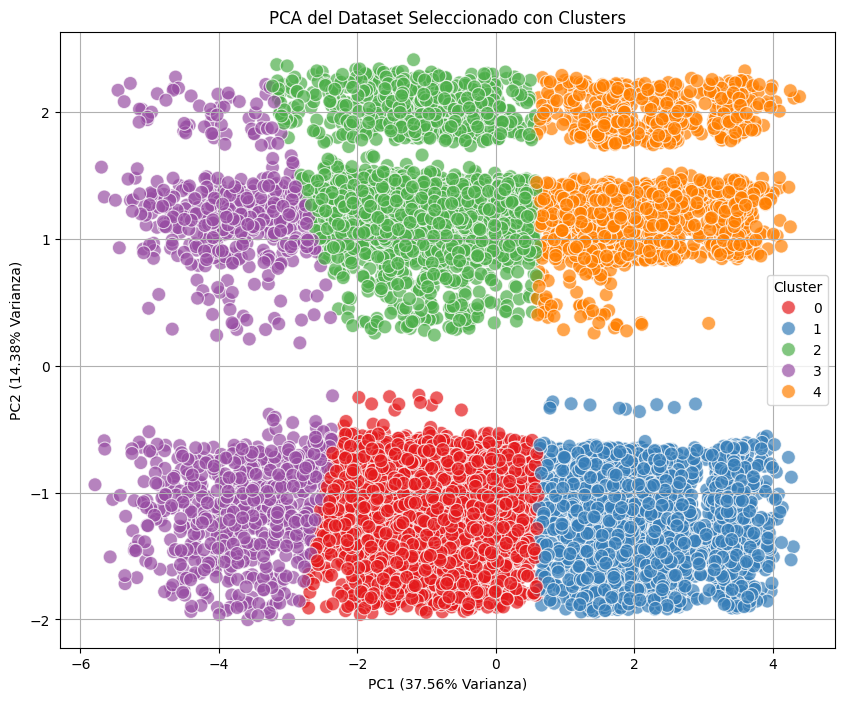

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\64113426.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


In [12]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

### Detalles de cada cluster

In [13]:
# Asegurarse de que 'Cluster' esté incluido en el DataFrame, aunque su flag esté desactivada
columns_to_include = [col for col, flag in flags.items() if flag] + ['Cluster']

# Seleccionar solo las columnas activas en el DataFrame
df_filtered = df_selected[columns_to_include]

# Agrupar por los clusters y calcular la moda para cada grupo
cluster_summary = df_filtered.groupby('Cluster').agg(lambda x: x.mode()[0])

# Mostrar las características de cada cluster (moda)
print("\nResumen de características por cluster (moda):")
print(cluster_summary)

# Si quieres ver también el conteo de elementos por cluster
cluster_count = df_filtered['Cluster'].value_counts()
print("\nConteo de elementos por cluster:")
print(cluster_count)

# Agrupar por cluster y calcular la moda para las columnas activas
# Usar 'mode' para obtener la moda
agg_functions = {col: lambda x: x.mode()[0] if df_selected[col].dtype in ['object', 'bool'] else 'mean' for col in columns_to_include if col != 'Cluster'}

cluster_description = df_filtered.groupby('Cluster').agg(agg_functions)

# Mostrar el resumen detallado por cluster con la moda
print("\nResumen detallado por cluster (moda):")
cluster_description


Resumen de características por cluster (moda):
         Genero  Casado  Edad  Graduado  Profesion  Experiencia_laboral  \
Cluster                                                                   
0             1     1.0    46       1.0          0                    2   
1             1     0.0    39       0.0          3                    0   
2             1     1.0    44       1.0          0                    2   
3             1     1.0    79       1.0          8                    2   
4             1     0.0    39       0.0          3                    0   

         Gastoscore  Family_Size  anno_nacimiento  Generacion  \
Cluster                                                         
0                 0            2             1978         2.0   
1                 0            3             1985         3.0   
2                 0            2             1980         2.0   
3                 2            2             1945         0.0   
4                 0            4    

,Genero,Casado,Edad,Graduado,Profesion,Experiencia_laboral,Gastoscore,Family_Size,anno_nacimiento,Generacion,Ingresos_anuales_brutos,Digital_encuesta,Gasto_medio_mensual_cuota,Abandono,Dias_cliente,Campanna_anno
Cluster,,,,,,,,,,,,,,,,
0,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
1,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
2,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
3,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
4,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean


## Cálculo nº clusters

#### Paso 1: Calcular la inercia para diferentes valores de k

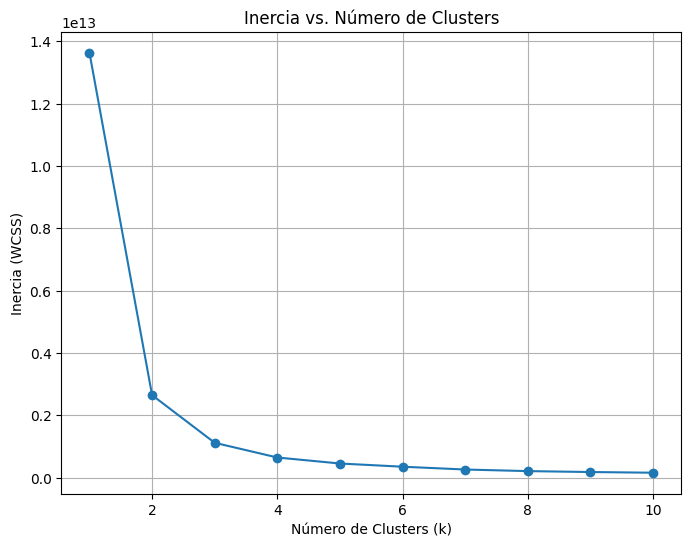

In [14]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import numpy as np

# Definir los rangos de k que vamos a probar (por ejemplo, de 1 a 10)
k_values = range(1, 11)
inercia = []

# Calcular inercia para cada valor de k
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df)  # Asegúrate de pasar solo las columnas numéricas
    inercia.append(kmeans.inertia_)

# Visualizar la inercia frente al número de clusters
plt.figure(figsize=(8, 6))
plt.plot(k_values, inercia, marker='o')
plt.title('Inercia vs. Número de Clusters')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('Inercia (WCSS)')
plt.grid(True)
plt.show()


### Paso 2: Identificar el "codo"

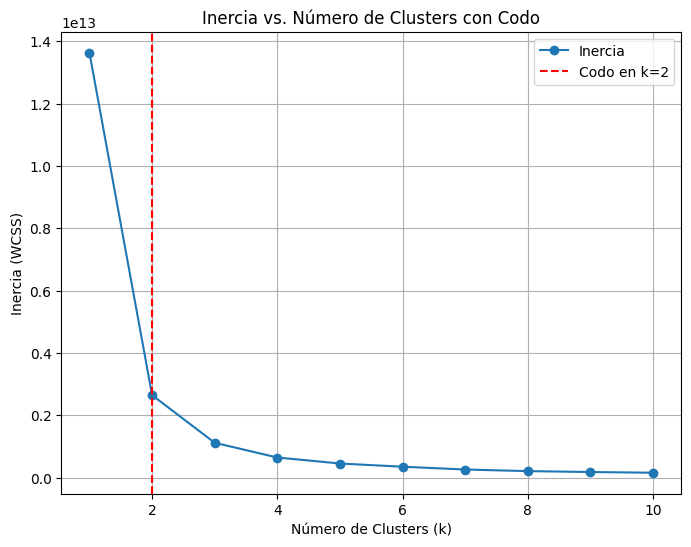

El valor óptimo de k, basado en el codo, es: 2


In [15]:
# Calcular la derivada de la inercia (diferencias entre puntos consecutivos)
inercia_derivada = np.diff(inercia)

# Encontrar el índice donde ocurre el mayor cambio (el codo)
codo_indice = np.argmin(inercia_derivada) + 1  # +1 porque np.diff reduce el tamaño del array

# Visualizar el gráfico de inercia con la derivada
plt.figure(figsize=(8, 6))
plt.plot(k_values, inercia, marker='o', label='Inercia')
plt.axvline(x=k_values[codo_indice], color='r', linestyle='--', label=f'Codo en k={k_values[codo_indice]}')
plt.title('Inercia vs. Número de Clusters con Codo')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('Inercia (WCSS)')
plt.legend()
plt.grid(True)
plt.show()

# Mostrar el valor de k óptimo
print(f"El valor óptimo de k, basado en el codo, es: {k_values[codo_indice]}")

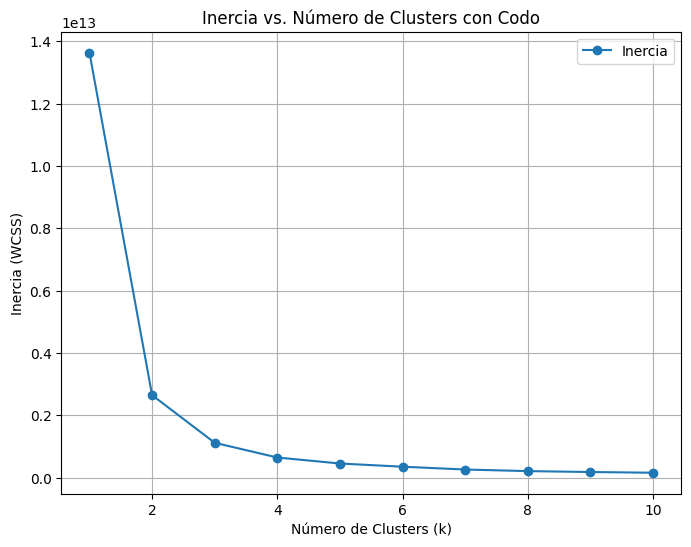

El valor óptimo de k, basado en el codo, es: 4


In [16]:
# Calcular la derivada de la inercia (diferencias entre puntos consecutivos)
inercia_derivada = np.diff(inercia)

# Encontrar el índice donde ocurre el mayor cambio (el codo)
codo_indice = np.argmin(inercia_derivada) + 1  # +1 porque np.diff reduce el tamaño del array

# Visualizar el gráfico de inercia con la derivada
plt.figure(figsize=(8, 6))
plt.plot(k_values, inercia, marker='o', label='Inercia')
plt.title('Inercia vs. Número de Clusters con Codo')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('Inercia (WCSS)')
plt.legend()
plt.grid(True)
plt.show()

# Mostrar el valor de k óptimo
print(f"El valor óptimo de k, basado en el codo, es: 4")


### Paso 3: Intersección de la tangente

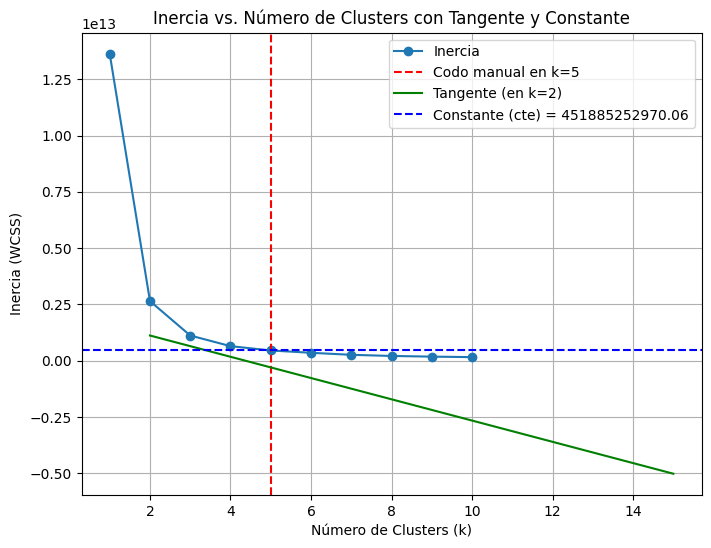

In [17]:
# Paso 3: Intersección de la tangente

# Fijar el codo manualmente en el cluster 4
codo_indice = 4

# Calcular la pendiente de la tangente en el punto del cluster 2
pendiente_tangente = inercia_derivada[2]  # Ahora calculamos la pendiente en el punto del cluster 2

# Definir la constante (cte), que será la inercia en el cluster 4
cte = inercia[4]  # Usamos la inercia en el cluster 4 como umbral de corte

# Generar la ecuación de la tangente en el punto del cluster 2
# Ecuación de la recta tangente: y = mx + b
# m es la pendiente y b es el valor en el punto del cluster 2 (inercia[codo_indice])

x_tangente = np.linspace(2, 15, 100)  # Puntos para graficar la tangente (ajustar el rango)
y_tangente = pendiente_tangente * (x_tangente - 2) + inercia[2]

# Graficar la inercia, la tangente y la intersección con la línea horizontal
plt.figure(figsize=(8, 6))
plt.plot(k_values, inercia, marker='o', label='Inercia')
plt.axvline(x=k_values[codo_indice], color='r', linestyle='--', label=f'Codo manual en k={k_values[codo_indice]}')
plt.plot(x_tangente, y_tangente, color='g', label='Tangente (en k=2)')
plt.axhline(y=cte, color='b', linestyle='--', label=f'Constante (cte) = {cte:.2f}')

# Título y etiquetas
plt.title('Inercia vs. Número de Clusters con Tangente y Constante')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('Inercia (WCSS)')
plt.legend()
plt.grid(True)
plt.show()

## PCA y Kmeans; k = 4

### Flags

In [18]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": True,
    "Profesion": True,
    "Experiencia_laboral": True,
    "Gastoscore": True,
    "Family_Size": True,
    "anno_nacimiento": False,
    "Generacion": True,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": True,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": True
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]

### PCA y Kmeans


Variables continuas seleccionadas para PCA: ['Profesion', 'Experiencia_laboral', 'Gastoscore', 'Family_Size', 'Generacion', 'Ingresos_anuales_brutos', 'Digital_encuesta', 'Gasto_medio_mensual_cuota', 'Dias_cliente', 'Campanna_anno']

Datos estandarizados:
   Profesion  Experiencia_laboral  Gastoscore  Family_Size  Generacion  \
0   0.268026             0.775758   -0.731429     0.152186   -0.432755   
1   0.623398             0.775758    0.621270    -0.493738   -0.432755   
2  -1.153465             0.775758    0.621270     0.152186   -0.432755   
3  -0.087347            -0.470020   -0.731429     0.798110    0.617874   
4   1.334144             0.775758    0.621270    -0.493738   -0.432755   

   Ingresos_anuales_brutos  Digital_encuesta  Gasto_medio_mensual_cuota  \
0                 1.052800         -0.099417                   1.210732   
1                 1.231385         -0.255354                   0.164441   
2                -0.545951          0.056052                  -0.533086  

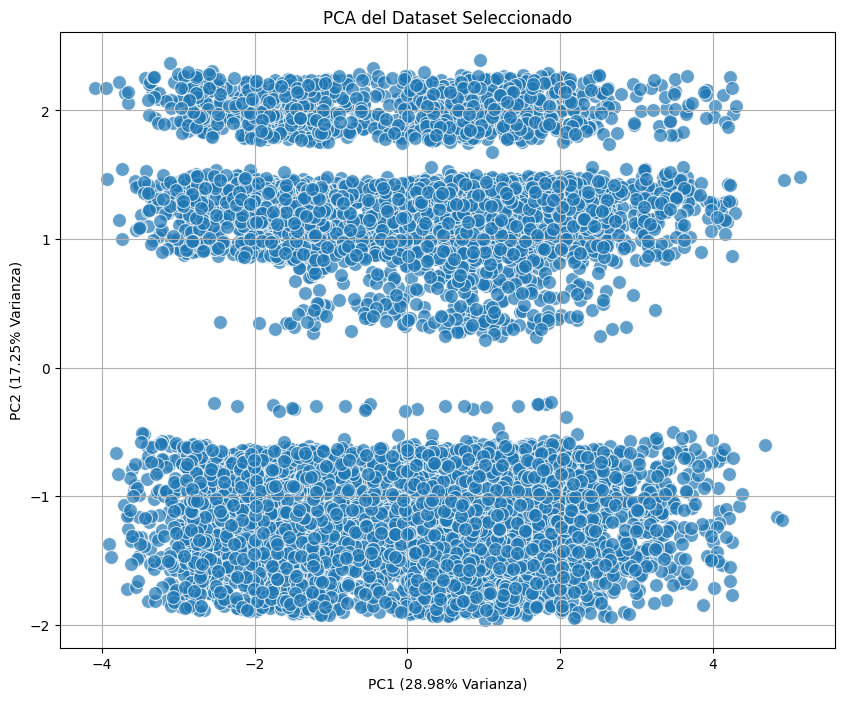

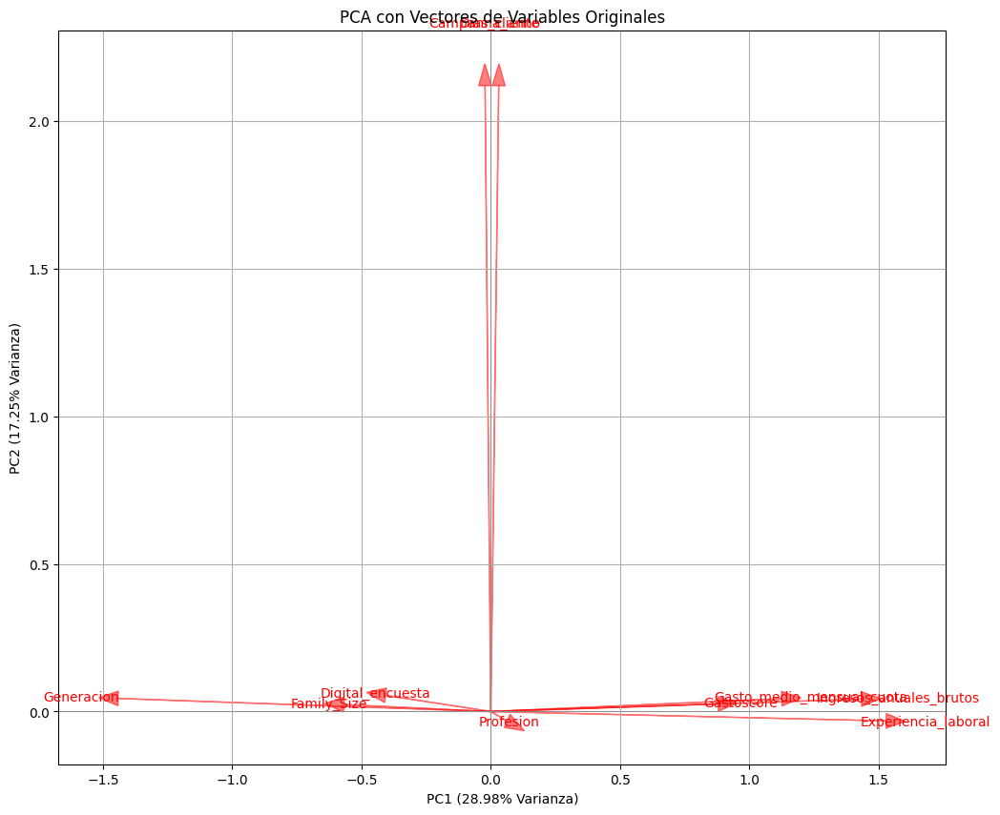


Cargas de las variables en las componentes principales:
                                PC1       PC2
Profesion                  0.021087 -0.010594
Experiencia_laboral        0.509618 -0.010551
Gastoscore                 0.292999  0.008626
Family_Size               -0.189339  0.007846
Generacion                -0.480321  0.014791
Ingresos_anuales_brutos    0.477733  0.014042
Digital_encuesta          -0.135631  0.018291
Gasto_medio_mensual_cuota  0.375039  0.014529
Dias_cliente               0.010219  0.706609
Campanna_anno             -0.007406  0.706671


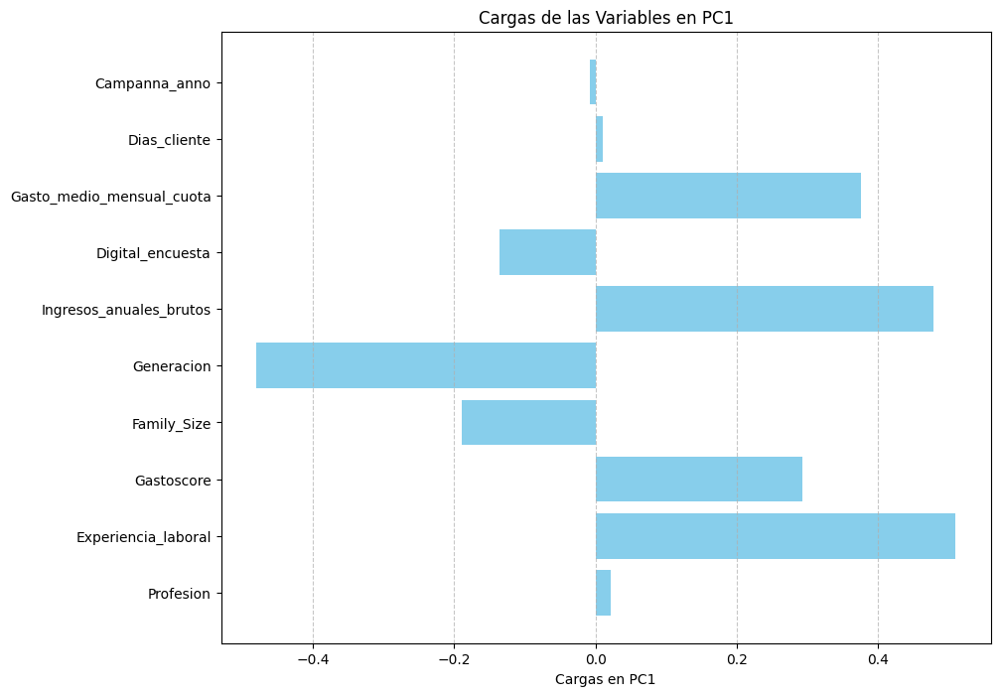

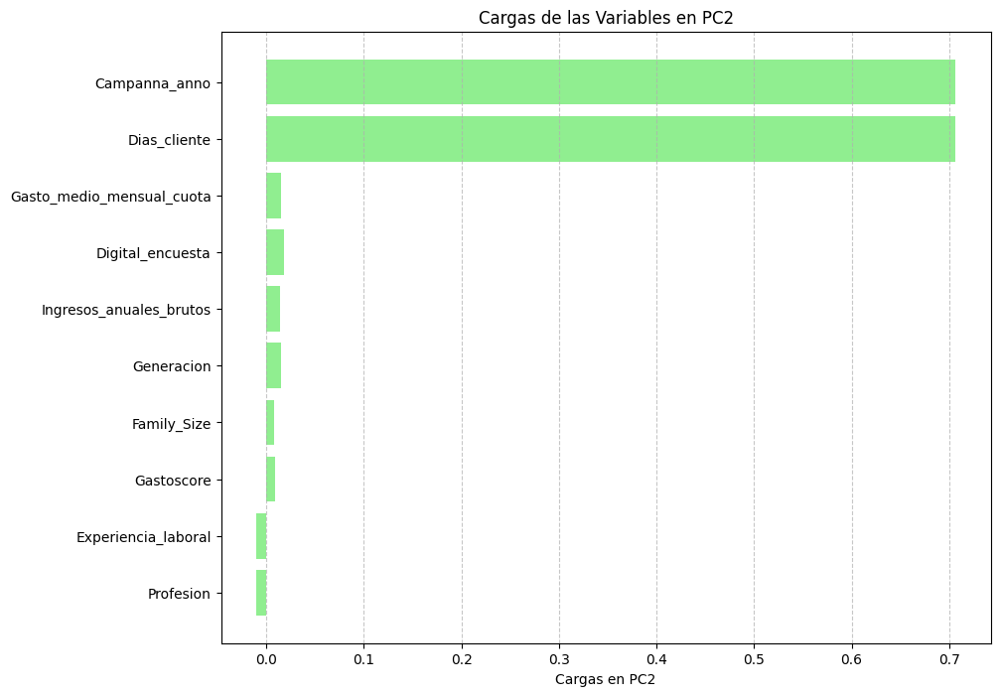

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


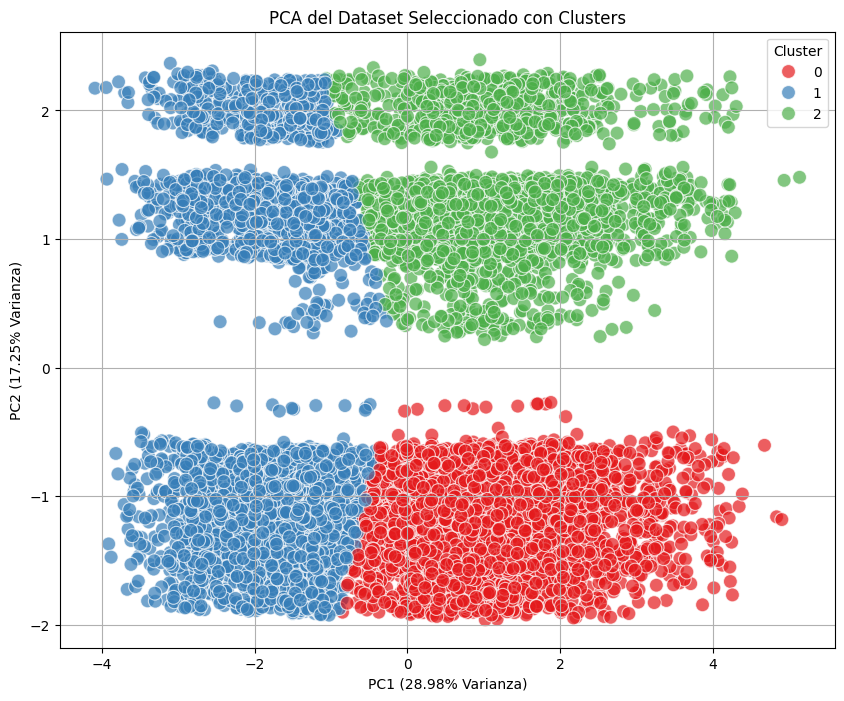

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

### Detalles de cada cluster

In [20]:
from sklearn.cluster import KMeans

# Asegurarse de que las características estén normalizadas o escaladas si es necesario
features = df[['Edad', 'Family_Size', 'Gastoscore', 'Ingresos_anuales_brutos']]  # Agrega las columnas que necesites
kmeans = KMeans(n_clusters=3, random_state=42)  # Ajusta el número de clusters según lo que necesites
df['Cluster'] = kmeans.fit_predict(features)


In [21]:
# 6. Calcular la moda por cluster
cluster_mode = df.groupby('Cluster').agg(lambda x: x.mode()[0] if x.dtype != 'O' else x.mode()[0])

# 7. Mostrar la moda de cada flag por cluster
print("\nModa de cada flag por cluster:")
print(cluster_mode)


Moda de cada flag por cluster:
         Genero  Casado  Edad  Graduado  Profesion  Experiencia_laboral  \
Cluster                                                                   
0             1     1.0    46       1.0          0                    2   
1             1     0.0    39       1.0          3                    0   
2             1     1.0    46       1.0          0                    2   

         Gastoscore  Family_Size  anno_nacimiento  Generacion  \
Cluster                                                         
0                 0            2             1978         2.0   
1                 0            2             1985         3.0   
2                 0            2             1978         2.0   

         Ingresos_anuales_brutos  Provincia  Digital_encuesta  \
Cluster                                                         
0                          49328         27             896.0   
1                          18461         27            1031.0   
2     


Características de cada cluster:
           Genero    Casado  Graduado  Profesion  Experiencia_laboral  \
Cluster                                                                 
0        0.553663  0.804940  0.745599   3.176604             1.935832   
1        0.534593  0.230128  0.425417   3.388862             0.470805   
2        0.553304  0.821072  0.741895   3.139963             1.915835   

         Gastoscore  Family_Size  Generacion  Ingresos_anuales_brutos  \
Cluster                                                                 
0          0.776547     2.457127    1.887280             74907.890403   
1          0.146712     3.270118    3.253435             24411.802502   
2          0.782419     2.459165    1.918641             75758.748130   

         Digital_encuesta  Gasto_medio_mensual_cuota  Abandono  Dias_cliente  \
Cluster                                                                        
0             1314.145088                  54.363998  0.384157    181.1396

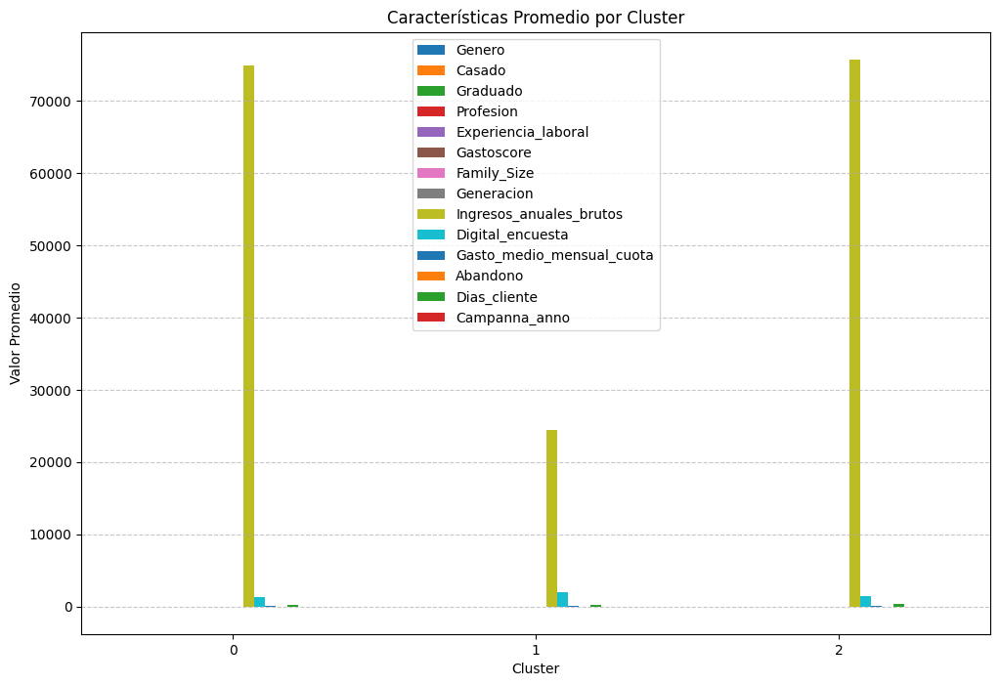

In [22]:
# Agrupar por el cluster y obtener la media de las características
cluster_summary = df_selected.groupby('Cluster').mean()

# Mostrar las características de cada cluster
print("\nCaracterísticas de cada cluster:")
print(cluster_summary)

# Si prefieres la moda, puedes usar .agg() para calcular la moda por cluster
cluster_mode = df_selected.groupby('Cluster').agg(lambda x: x.mode()[0] if x.dtype == 'O' else x.mean())

print("\nCaracterísticas de cada cluster (Moda o media según corresponda):")
print(cluster_mode)

# Visualizar las características de cada cluster
# Puedes crear un gráfico de barras para cada característica, usando el DataFrame cluster_summary
cluster_summary.plot(kind='bar', figsize=(12,8))
plt.title('Características Promedio por Cluster')
plt.ylabel('Valor Promedio')
plt.xlabel('Cluster')
plt.xticks(rotation=0)
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()


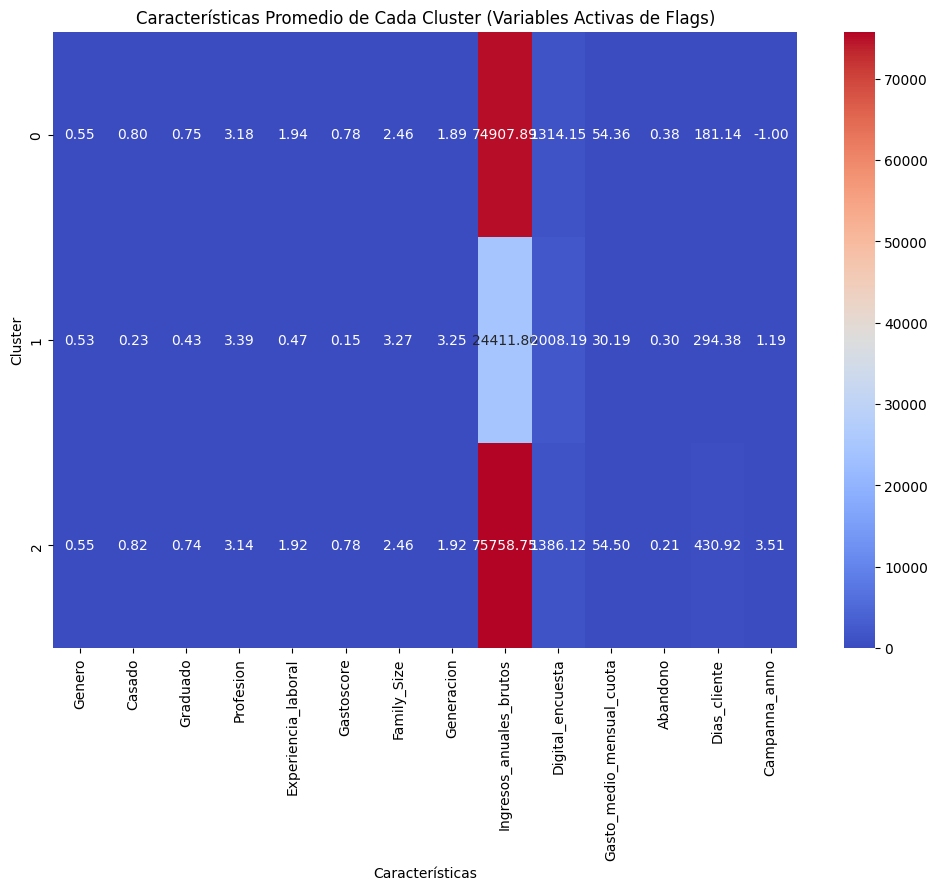

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filtrar las columnas que están activadas en 'flags'
columns_to_include = [col for col, flag in flags.items() if flag]

# Asegurarse de que estas columnas estén en el DataFrame
df_flags = df_selected[columns_to_include + ['Cluster']]

# Calcular la media de las variables para cada cluster
cluster_summary_flags = df_flags.groupby('Cluster').mean()

# Visualizar las características de cada cluster utilizando un heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(cluster_summary_flags, annot=True, cmap='coolwarm', fmt='.2f', cbar=True)
plt.title('Características Promedio de Cada Cluster (Variables Activas de Flags)')
plt.xlabel('Características')
plt.ylabel('Cluster')
plt.show()


Resumen de características por cluster:
           Genero    Casado  Graduado  Profesion  Experiencia_laboral  \
Cluster                                                                 
0        0.553663  0.804940  0.745599   3.176604             1.935832   
1        0.534593  0.230128  0.425417   3.388862             0.470805   
2        0.553304  0.821072  0.741895   3.139963             1.915835   

         Gastoscore  Family_Size  Generacion  Ingresos_anuales_brutos  \
Cluster                                                                 
0          0.776547     2.457127    1.887280             74907.890403   
1          0.146712     3.270118    3.253435             24411.802502   
2          0.782419     2.459165    1.918641             75758.748130   

         Digital_encuesta  Gasto_medio_mensual_cuota  Abandono  Dias_cliente  \
Cluster                                                                        
0             1314.145088                  54.363998  0.384157    18

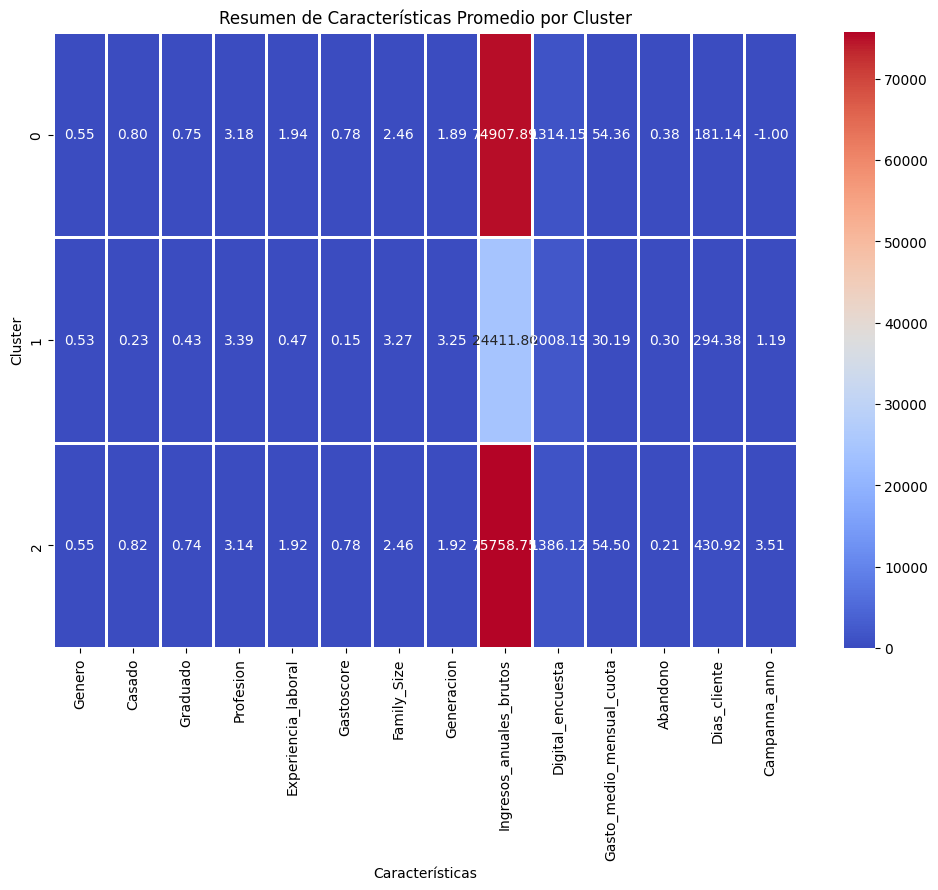

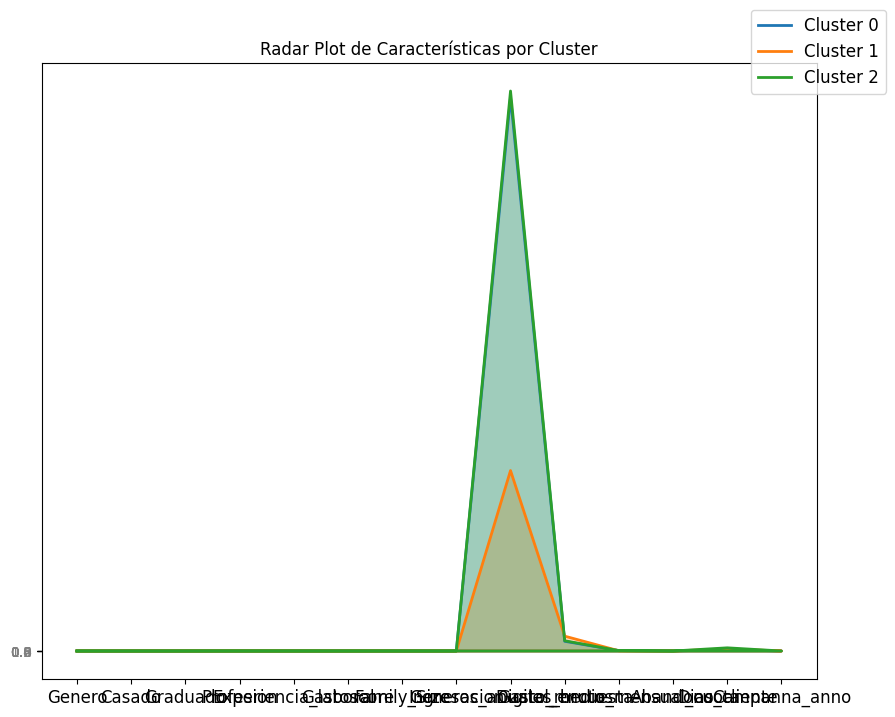

In [24]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns

# Filtrar las columnas activas en flags
columns_to_include = [col for col, flag in flags.items() if flag]

# Filtrar el dataframe con las columnas activadas y el cluster
df_flags = df_selected[columns_to_include + ['Cluster']]

# Calcular el resumen de cada cluster
cluster_summary_flags = df_flags.groupby('Cluster').mean()

# Mostrar la tabla de resumen de cada cluster
print("Resumen de características por cluster:")
print(cluster_summary_flags)

# Visualización: Tabla con características promedio por cluster
plt.figure(figsize=(12, 8))
sns.heatmap(cluster_summary_flags, annot=True, cmap='coolwarm', fmt='.2f', cbar=True, linewidths=1)
plt.title('Resumen de Características Promedio por Cluster')
plt.xlabel('Características')
plt.ylabel('Cluster')
plt.show()

# Ahora, generamos un Radar Plot para cada cluster, para visualizar las diferencias
# Preparar datos para radar plot
categories = cluster_summary_flags.columns.tolist()  # Las variables de características
clusters = cluster_summary_flags.index.tolist()  # Los índices de los clusters

# Función para crear radar plot
def radar_plot(data, categories, clusters):
    N = len(categories)  # Número de características
    angles = np.linspace(0, 2 * np.pi, N, endpoint=False).tolist()  # Ángulos para el gráfico radial
    angles += angles[:1]  # Cerrar el círculo

    plt.figure(figsize=(10, 8))
    
    # Plot cada cluster
    for cluster in clusters:
        values = data.loc[cluster].values.flatten().tolist()  # Valores de características para cada cluster
        values += values[:1]  # Cerrar el círculo
        plt.plot(angles, values, label=f'Cluster {cluster}', linewidth=2, linestyle='solid')
        plt.fill(angles, values, alpha=0.25)

    plt.title('Radar Plot de Características por Cluster')
    plt.xticks(angles[:-1], categories, color='black', size=12)
    plt.yticks(np.arange(0, 1.1, 0.2), color='grey', size=10)
    plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1), fontsize=12)
    plt.show()

# Crear el radar plot
radar_plot(cluster_summary_flags, categories, clusters)


---
#### dibujos


Características de cada cluster (Moda):
         Genero  Casado  Graduado  Profesion  Experiencia_laboral  Gastoscore  \
Cluster                                                                         
0             1     1.0       1.0          0                    2           0   
1             1     0.0       0.0          3                    0           0   
2             1     1.0       1.0          0                    2           0   

         Family_Size  Generacion  Ingresos_anuales_brutos  Digital_encuesta  \
Cluster                                                                       
0                  2         2.0                    49328            1639.0   
1                  4         3.0                    18461            2043.0   
2                  2         2.0                    21092            1385.0   

         Gasto_medio_mensual_cuota  Abandono  Dias_cliente  Campanna_anno  
Cluster                                                                    
0    

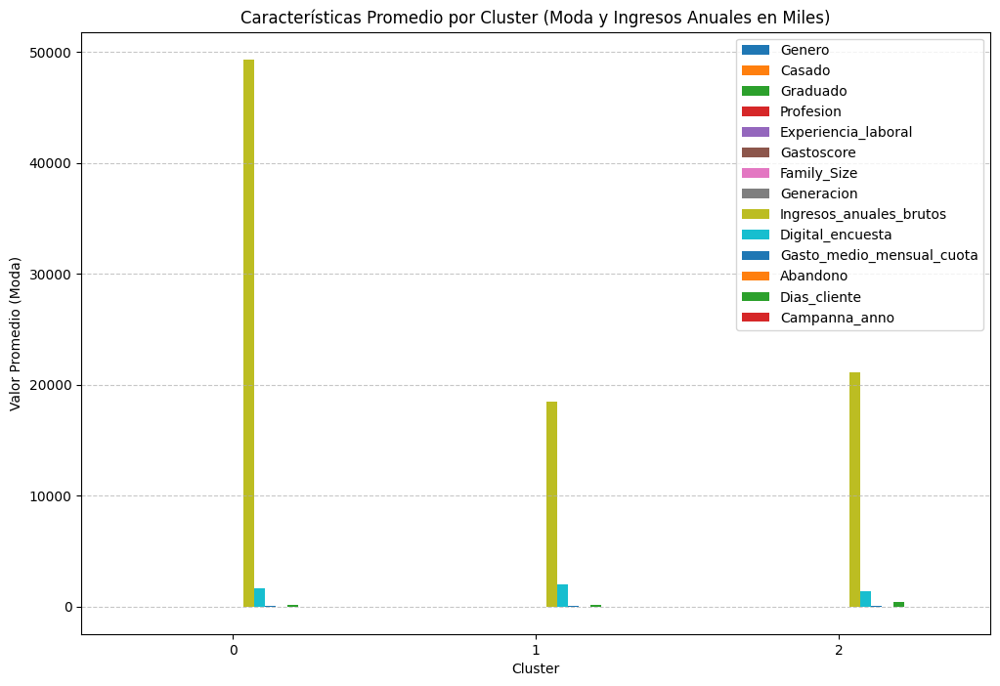

In [25]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Asegurarse de que la columna 'annual_income' está presente
if 'annual_income' in df_selected.columns:
    # Dividir los ingresos anuales por 1000 para mejor visualización
    df_selected['annual_income'] = df_selected['annual_income'] / 1000

# Agrupar por el cluster y obtener la moda de las características (no la media)
cluster_mode = df_selected.groupby('Cluster').agg(lambda x: x.mode()[0] if x.dtype != 'O' else x.mode()[0])

# Mostrar las características por cluster con la moda
print("\nCaracterísticas de cada cluster (Moda):")
print(cluster_mode)

# Visualizar las características de cada cluster como gráfico de barras
cluster_mode.plot(kind='bar', figsize=(12, 8))
plt.title('Características Promedio por Cluster (Moda y Ingresos Anuales en Miles)')
plt.ylabel('Valor Promedio (Moda)')
plt.xlabel('Cluster')
plt.xticks(rotation=0)
plt.grid(True, axis='y', linestyle='--', alpha=0.7)
plt.show()


---
## Recursivo para encontrar la mejor clusterizacion

In [26]:
# import itertools
# import numpy as np
# import pandas as pd
# import matplotlib.pyplot as plt
# import seaborn as sns
# from sklearn.decomposition import PCA
# from sklearn.preprocessing import StandardScaler
# from sklearn.cluster import KMeans
# from sklearn.metrics import silhouette_score

# # Configuración de visualización
# plt.ion()  # Modo interactivo para mostrar gráficos en tiempo real
# sns.set_palette('viridis')
# pd.set_option('display.max_columns', None)

# # Función mejorada con visualización en tiempo real
# def evaluate_and_plot(df, features, n_clusters=3, plot=True):
#     try:
#         # Seleccionar y limpiar datos
#         df_subset = df[features].dropna()
#         if len(df_subset) < 10:
#             print(f"✗ {', '.join(features)}: Muestras insuficientes ({len(df_subset)})")
#             return None, None, None
        
#         # Estandarizar y aplicar PCA
#         scaler = StandardScaler()
#         X_scaled = scaler.fit_transform(df_subset)
#         pca = PCA(n_components=2)
#         principal_components = pca.fit_transform(X_scaled)
        
#         # Clustering con K-Means (siempre 3 clusters)
#         kmeans = KMeans(n_clusters=n_clusters, random_state=42)
#         clusters = kmeans.fit_predict(principal_components)
#         score = silhouette_score(principal_components, clusters)
        
#         # Crear DataFrame con resultados
#         pca_df = pd.DataFrame(principal_components, columns=['PC1', 'PC2'])
#         pca_df['Cluster'] = clusters
        
#         # Mostrar resultados en consola
#         print(f"\n✓ Combinación evaluada: {', '.join(features)}")
#         print(f"   • Silhouette Score: {score:.3f}")
#         print(f"   • Varianza explicada: PC1={pca.explained_variance_ratio_[0]*100:.1f}%, PC2={pca.explained_variance_ratio_[1]*100:.1f}%")
#         print(f"   • Muestras: {len(df_subset)}")
        
#         # Visualización en tiempo real
#         if plot:
#             plt.figure(figsize=(10, 6))
#             sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, 
#                            palette='viridis', s=80, alpha=0.8)
#             plt.title(f"Combinación: {', '.join(features)}\nScore: {score:.3f} | Varianza: {sum(pca.explained_variance_ratio_)*100:.1f}%")
#             plt.xlabel(f"PC1 ({pca.explained_variance_ratio_[0]*100:.1f}%)")
#             plt.ylabel(f"PC2 ({pca.explained_variance_ratio_[1]*100:.1f}%)")
#             plt.grid(True)
#             plt.tight_layout()
#             plt.draw()
#             plt.pause(1.5)  # Pausa para visualización
#             plt.close()
        
#         return pca_df, score, pca.explained_variance_ratio_
    
#     except Exception as e:
#         print(f"✗ Error con {', '.join(features)}: {str(e)}")
#         return None, None, None

# # Función principal de búsqueda
# def search_best_combination(df, features_list, min_features=3, max_features=7):
#     all_results = []
#     feature_combinations = []
    
#     # Generar todas las combinaciones posibles
#     for r in range(min_features, max_features + 1):
#         feature_combinations.extend(list(itertools.combinations(features_list, r)))
    
#     print(f"\n🔍 Iniciando evaluación de {len(feature_combinations)} combinaciones...")
    
#     for i, combo in enumerate(feature_combinations, 1):
#         print(f"\n📊 Progreso: {i}/{len(feature_combinations)}")
#         print("="*50)
        
#         pca_df, score, variance = evaluate_and_plot(df, list(combo), n_clusters=3)
        
#         if score is not None:
#             all_results.append({
#                 'features': list(combo),
#                 'score': score,
#                 'variance': variance,
#                 'pca_df': pca_df
#             })
    
#     return all_results

# # Variables disponibles (ajustar según tu dataset)
# features = ['Genero', 'Casado', 'Graduado', 'Profesion', 'Experiencia_laboral',
#             'Gastoscore', 'Family_Size', 'Generacion', 'Ingresos_anuales_brutos',
#             'Digital_encuesta', 'Gasto_medio_mensual_cuota', 'Abandono',
#             'Dias_cliente', 'Campanna_anno']

# # Ejecutar la búsqueda
# print("="*60)
# print("🚀 INICIANDO BÚSQUEDA EXHAUSTIVA DE COMBINACIONES")
# print(f"Variables: {', '.join(features)}")
# print(f"Clusters: 3 | Rango de variables: 3-7")
# print("="*60)

# results = search_best_combination(df, features)

# # Procesar resultados finales
# if not results:
#     print("\n⚠️ No se encontraron combinaciones válidas")
# else:
#     # Crear DataFrame de resultados
#     results_df = pd.DataFrame([{
#         'features': ', '.join(res['features']),
#         'num_features': len(res['features']),
#         'score': res['score'],
#         'variance': sum(res['variance']),
#         'pc1_var': res['variance'][0],
#         'pc2_var': res['variance'][1]
#     } for res in results])
    
#     # Mostrar top 10
#     print("\n" + "="*60)
#     print("🏆 TOP 10 COMBINACIONES")
#     print("="*60)
#     print(results_df.sort_values('score', ascending=False).head(10).to_string(index=False))
    
#     # Visualizar la mejor combinación
#     best = max(results, key=lambda x: x['score'])
#     plt.figure(figsize=(12, 8))
#     sns.scatterplot(x='PC1', y='PC2', hue='Cluster', 
#                    data=best['pca_df'], palette='viridis', s=100)
#     plt.title(f"MEJOR CLUSTERIZACIÓN ENCONTRADA\nVariables: {', '.join(best['features'])}\n"
#               f"Score: {best['score']:.3f} | Varianza: {sum(best['variance'])*100:.1f}%")
#     plt.xlabel(f"PC1 ({best['variance'][0]*100:.1f}%)")
#     plt.ylabel(f"PC2 ({best['variance'][1]*100:.1f}%)")
#     plt.grid(True)
#     plt.tight_layout()
#     plt.show()

---

In [27]:
# import pandas as pd
# import numpy as np
# import matplotlib.pyplot as plt
# import seaborn as sns

# from sklearn.decomposition import PCA
# from sklearn.preprocessing import StandardScaler
# from sklearn.cluster import KMeans
# from sklearn.metrics import silhouette_score

# # --- Parte 1: Preprocesamiento (según tu código original) ---

# # 1. Binarias
# bin_map = {
#     'Genero': {'F': 0, 'M': 1},
#     'Casado': {'No': 0, 'Si': 1},
#     'Graduado': {'No': 0, 'Si': 1},
#     'Abandono': {False: 0, True: 1}
# }
# for col, mapping in bin_map.items():
#     df[col] = df[col].map(mapping)

# # 2. Ordinales con orden definido
# df['Experiencia_laboral'] = df['Experiencia_laboral'].map({
#     '<10annos': 0, '10-20annos': 1, '+20annos': 2
# })
# df['Gastoscore'] = df['Gastoscore'].map({
#     'Bajo': 0, 'Medio': 1, 'Alto': 2
# })
# df['Generacion'] = df['Generacion'].map({
#     'Generacion Silenciosa':0, 'Baby Boomers': 1, 'Generacion X': 2, 'Millennials': 3, 'Generacion Z': 4
# })
# df['Campanna_anno'] = pd.to_numeric(df['Campanna_anno'], errors='coerce')

# # 3. Nominales sin orden
# le_dict = {}
# for col in ['Profesion', 'Provincia']:
#     df[col] = df[col].astype(str).str.strip()
#     from sklearn.preprocessing import LabelEncoder
#     le = LabelEncoder()
#     df[col] = le.fit_transform(df[col])
#     le_dict[col] = dict(zip(le.classes_, le.transform(le.classes_)))

# # 4. Forzar columnas numéricas
# num_cols = ['Edad', 'Family_Size', 'anno_nacimiento',
#             'Ingresos_anuales_brutos', 'Digital_encuesta',
#             'Gasto_medio_mensual_cuota', 'Dias_cliente']
# for col in num_cols:
#     df[col] = pd.to_numeric(df[col], errors='coerce')

# # 5. Mostrar valores faltantes
# print("\nValores faltantes por columna:")
# print(df.isna().sum()[df.isna().sum() > 0])

# # --- Parte 2: Selección de variables según flags y PCA & Clustering ---

# # Flags para activar o desactivar columnas específicas  
# flags = {
#     "ID": False,
#     "Genero": True,
#     "Casado": True,
#     "Edad": False,
#     "Graduado": True,
#     "Profesion": True,
#     "Experiencia_laboral": True,
#     "Gastoscore": True,
#     "Family_Size": True,
#     "anno_nacimiento": False,
#     "Generacion": True,
#     "Ingresos_anuales_brutos": True,
#     "Provincia": False,
#     "Digital_encuesta": True,
#     "Gasto_medio_mensual_cuota": True,
#     "Abandono": True,
#     "Dias_cliente": True,
#     "Campanna_anno": True
# }

# # Generar la lista de variables disponibles de acuerdo a las flags (sólo las que estén activas)
# vars_list = [col for col, flag in flags.items() if flag]
# print("Variables activas:", vars_list)

# # Nota: Asegúrate de que df_selected tenga todas las columnas que están en vars_list.  
# # Por ejemplo, para este flujo, usaremos el DataFrame original "df"
# df_selected = df[vars_list].copy()

# # Definimos variables globales para almacenar la mejor solución
# best_score = -1
# best_subset = None
# best_result = None

# # Función que evalúa un subconjunto de variables:
# def evaluate_subset(subset):
#     global best_score, best_subset, best_result
    
#     # Debe haber al menos 1 variable en el subconjunto
#     if len(subset) == 0:
#         return
    
#     # Filtrar el DataFrame con el subconjunto de variables
#     df_subset = df_selected[list(subset)].dropna()
#     if df_subset.empty:
#         return
    
#     # Solo seguimos si tenemos datos numéricos (para PCA)
#     df_numeric = df_subset.select_dtypes(include=[np.number])
#     if df_numeric.empty:
#         return
    
#     # Estandarizar
#     scaler = StandardScaler()
#     X_scaled = scaler.fit_transform(df_numeric)
    
#     # Aplicar PCA a 2 componentes
#     pca = PCA(n_components=2)
#     pca_components = pca.fit_transform(X_scaled)
#     pca_df = pd.DataFrame(pca_components, columns=['PC1','PC2'])
    
#     # Clustering: KMeans para 3 clusters
#     kmeans = KMeans(n_clusters=3, random_state=42)
#     clusters = kmeans.fit_predict(pca_df[['PC1','PC2']])
#     pca_df['Cluster'] = clusters
    
#     # Calcular la métrica de silueta (si hay más de un cluster)
#     if len(set(clusters)) > 1:
#         score = silhouette_score(pca_df[['PC1','PC2']], clusters)
#     else:
#         score = -1
    
#     # Actualizamos la mejor combinación si el score es mayor
#     if score > best_score:
#         best_score = score
#         best_subset = subset.copy()
#         best_result = pca_df.copy()
#         print("Nueva mejor combinación:", best_subset, "con Silhouette Score:", best_score)

# # Función recursiva para generar todos los subconjuntos
# def recursive_subsets(current, index, variables):
#     if index == len(variables):
#         evaluate_subset(current)
#         return
#     # No incluir la variable actual
#     recursive_subsets(current, index+1, variables)
    
#     # Incluir la variable actual
#     current.add(variables[index])
#     recursive_subsets(current, index+1, variables)
#     current.remove(variables[index])

# # Iniciar la recursión con conjunto vacío
# recursive_subsets(set(), 0, vars_list)

# print("\nMejor combinación de variables:", best_subset)
# print("Mejor Silhouette Score:", best_score)

# # Mostrar la visualización del PCA con clusters para la mejor combinación
# if best_result is not None:
#     plt.figure(figsize=(10,8))
#     sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=best_result, palette='Set1', s=100, alpha=0.7)
#     plt.title('PCA del Dataset Seleccionado con la Mejor Combinación de Variables')
#     plt.xlabel('PC1')
#     plt.ylabel('PC2')
#     plt.grid(True)
#     plt.show()


---
## Proves


In [28]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": False,
    "Edad": False,
    "Graduado": True,
    "Profesion": True,
    "Experiencia_laboral": True,
    "Gastoscore": True,
    "Family_Size": False,
    "anno_nacimiento": False,
    "Generacion": True,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": True,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]


Variables continuas seleccionadas para PCA: ['Profesion', 'Experiencia_laboral', 'Gastoscore', 'Generacion', 'Ingresos_anuales_brutos', 'Digital_encuesta', 'Gasto_medio_mensual_cuota', 'Dias_cliente']

Datos estandarizados:
   Profesion  Experiencia_laboral  Gastoscore  Generacion  \
0   0.268026             0.775758   -0.731429   -0.432755   
1   0.623398             0.775758    0.621270   -0.432755   
2  -1.153465             0.775758    0.621270   -0.432755   
3  -0.087347            -0.470020   -0.731429    0.617874   
4   1.334144             0.775758    0.621270   -0.432755   

   Ingresos_anuales_brutos  Digital_encuesta  Gasto_medio_mensual_cuota  \
0                 1.052800         -0.099417                   1.210732   
1                 1.231385         -0.255354                   0.164441   
2                -0.545951          0.056052                  -0.533086   
3                -0.888343          0.004073                  -0.533086   
4                -0.741176       

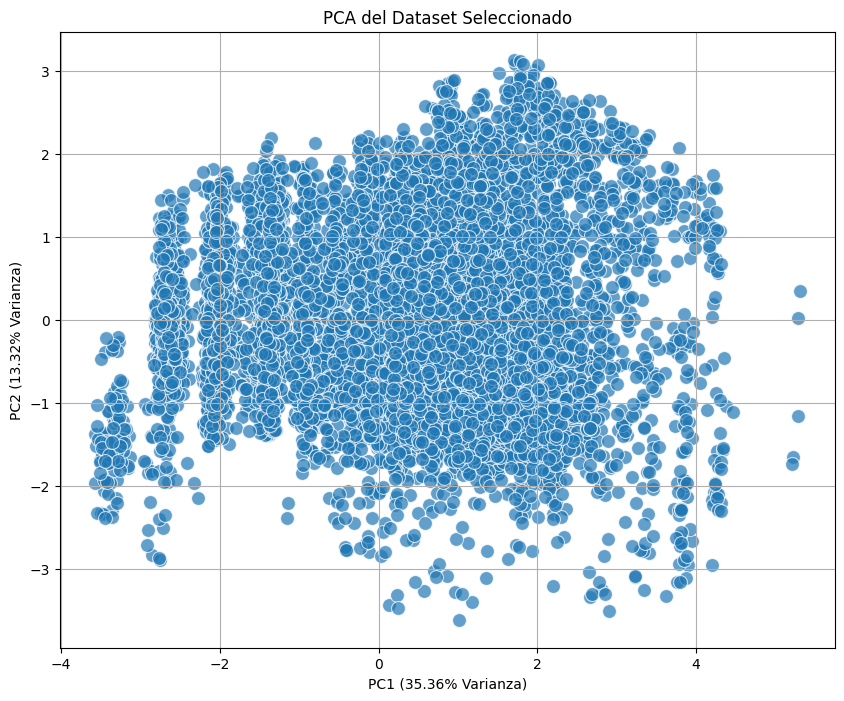

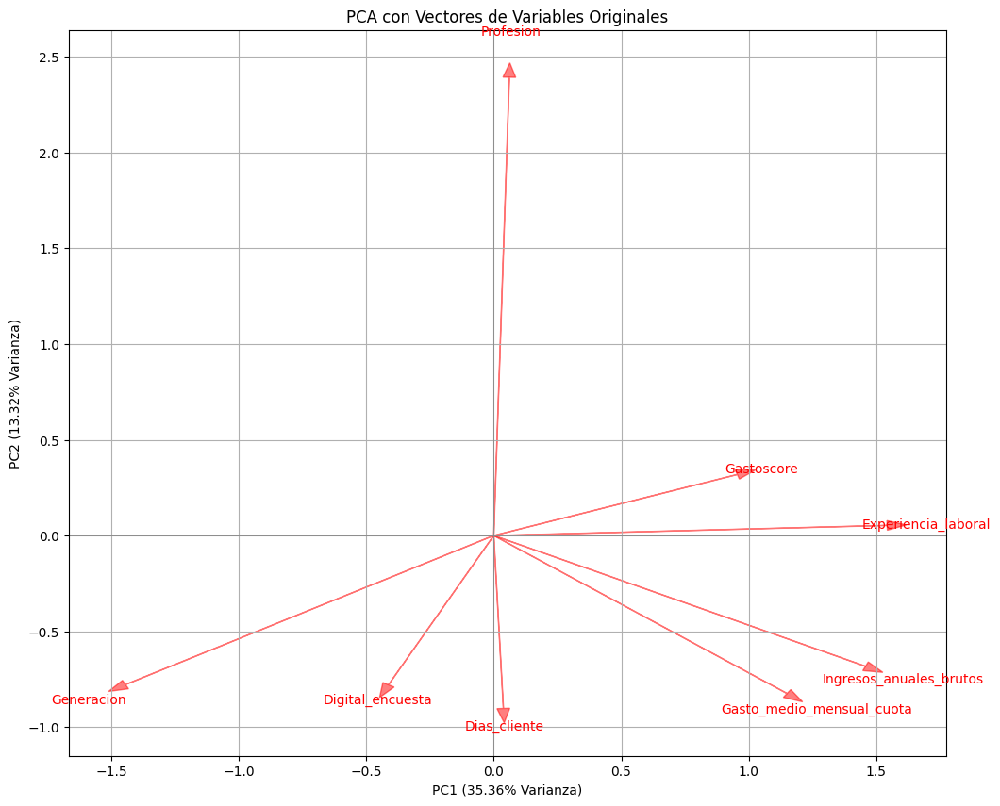


Cargas de las variables en las componentes principales:
                                PC1       PC2
Profesion                  0.020393  0.797496
Experiencia_laboral        0.514166  0.017616
Gastoscore                 0.318343  0.106178
Generacion                -0.481350 -0.259310
Ingresos_anuales_brutos    0.485934 -0.227459
Digital_encuesta          -0.137566 -0.259684
Gasto_medio_mensual_cuota  0.383355 -0.274790
Dias_cliente               0.012608 -0.300818


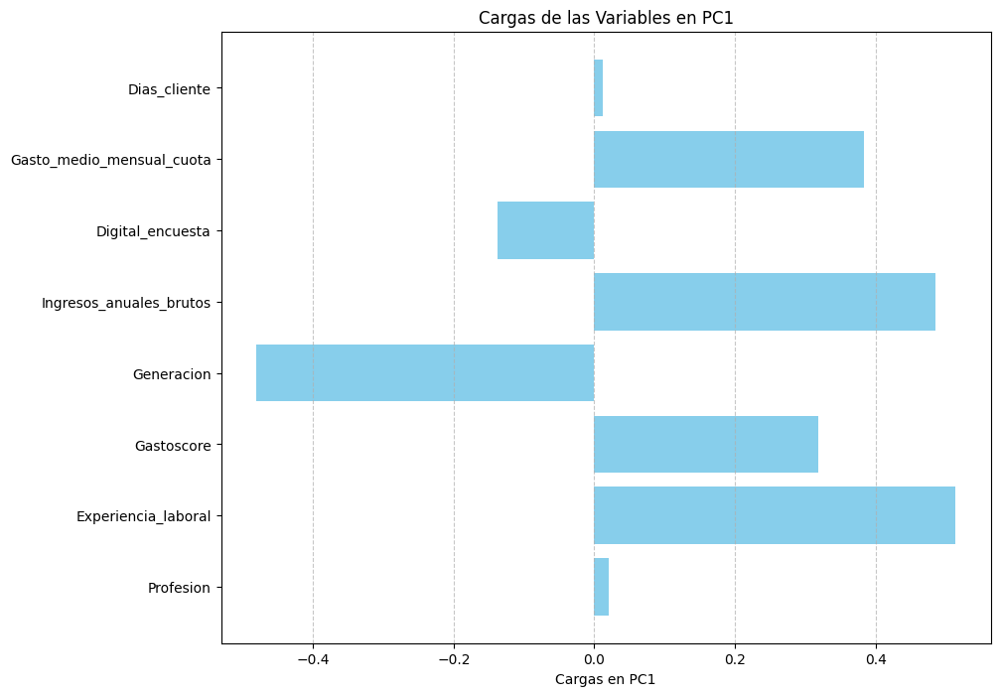

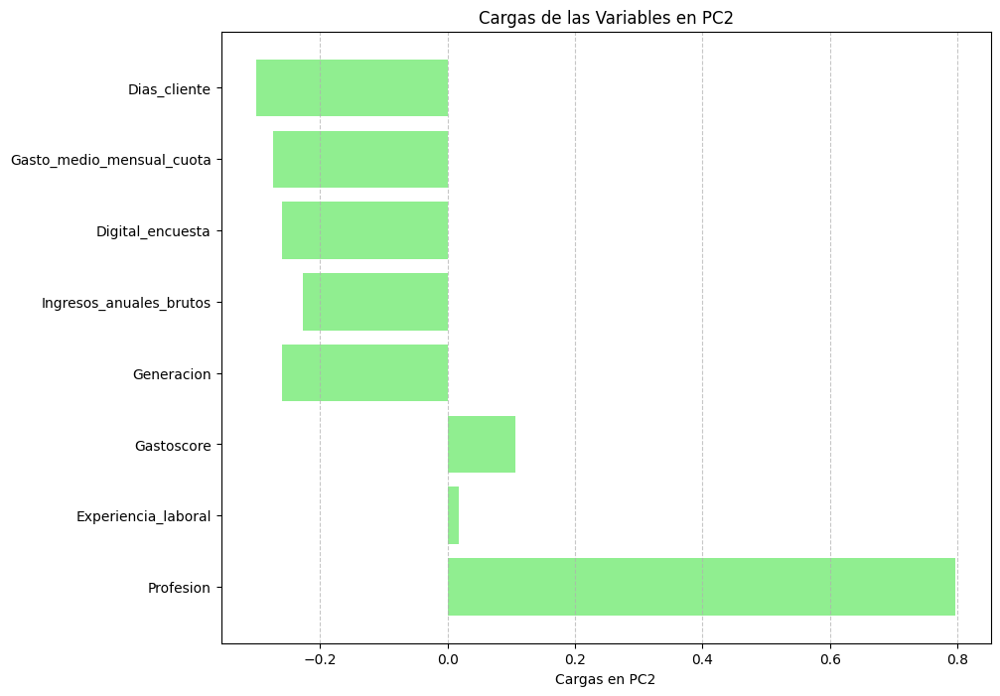

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


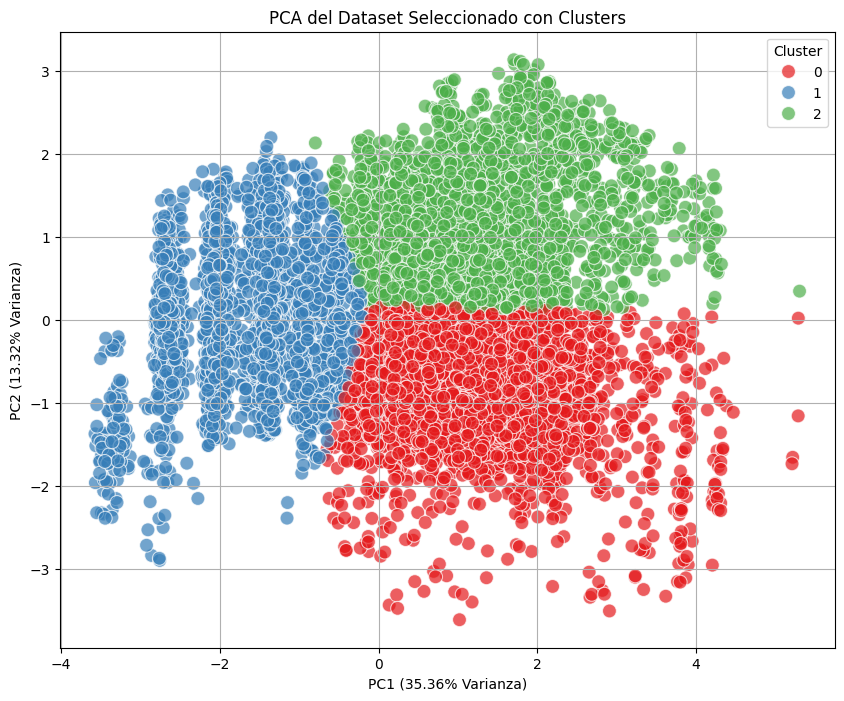

In [29]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

#### 2

In [30]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": False,
    "Edad": False,
    "Graduado": True,
    "Profesion": True,
    "Experiencia_laboral": True,
    "Gastoscore": True,
    "Family_Size": False,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": True,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]


Variables continuas seleccionadas para PCA: ['Profesion', 'Experiencia_laboral', 'Gastoscore', 'anno_nacimiento', 'Ingresos_anuales_brutos', 'Digital_encuesta', 'Gasto_medio_mensual_cuota', 'Dias_cliente']

Datos estandarizados:
   Profesion  Experiencia_laboral  Gastoscore  anno_nacimiento  \
0   0.268026             0.775758   -0.731429        -1.034957   
1   0.623398             0.775758    0.621270        -0.872187   
2  -1.153465             0.775758    0.621270        -0.926444   
3  -0.087347            -0.470020   -0.731429         0.809766   
4   1.334144             0.775758    0.621270        -0.221108   

   Ingresos_anuales_brutos  Digital_encuesta  Gasto_medio_mensual_cuota  \
0                 1.052800         -0.099417                   1.210732   
1                 1.231385         -0.255354                   0.164441   
2                -0.545951          0.056052                  -0.533086   
3                -0.888343          0.004073                  -0.533086  

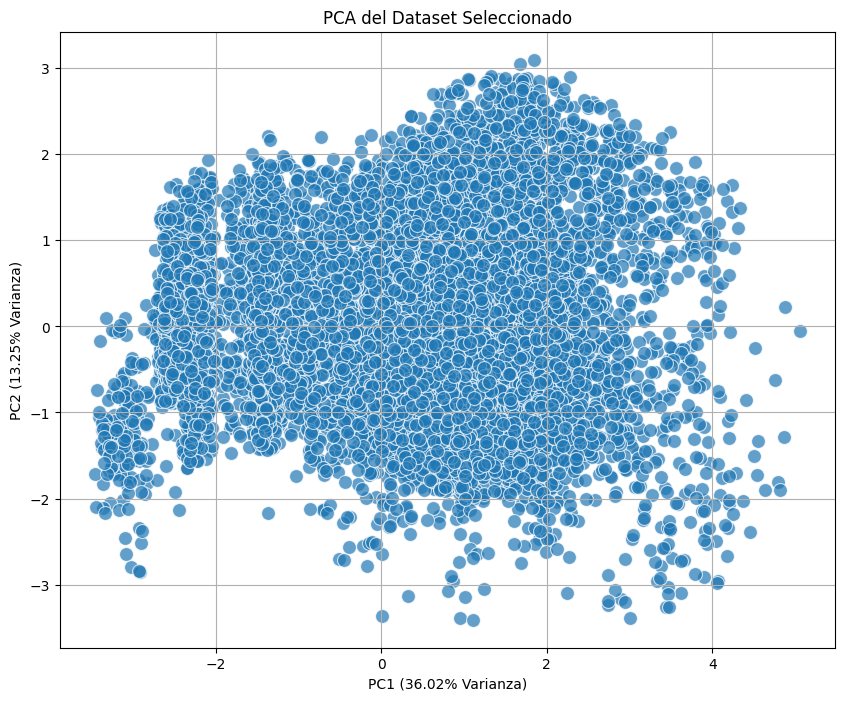

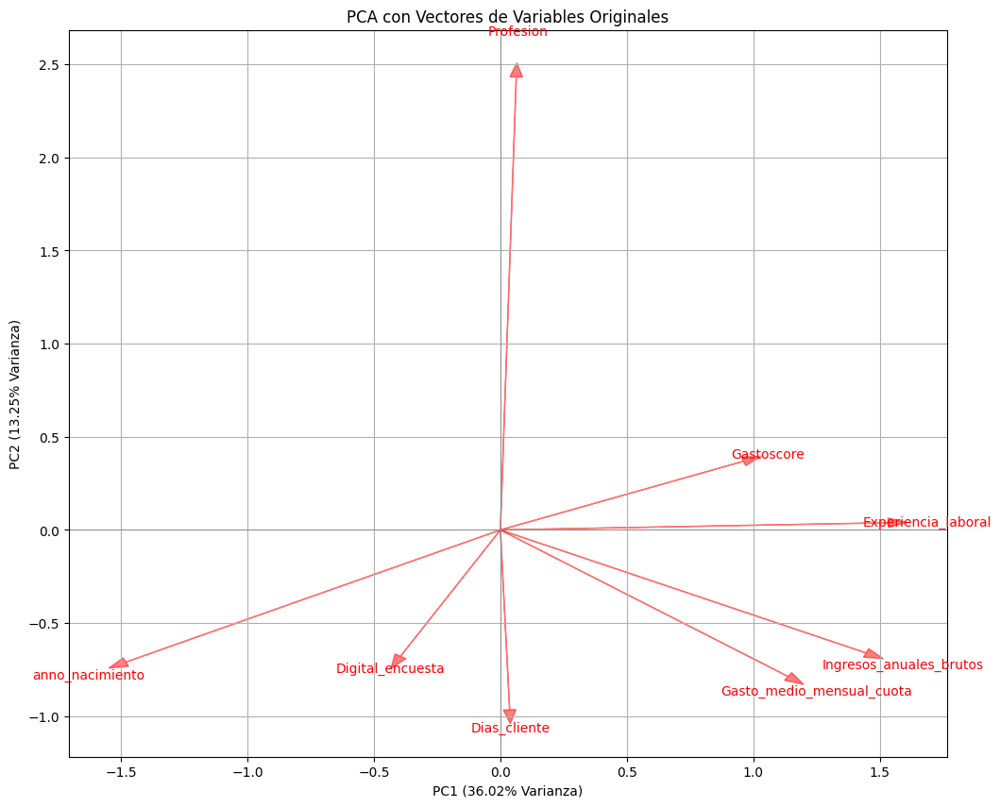


Cargas de las variables en las componentes principales:
                                PC1       PC2
Profesion                  0.020894  0.810636
Experiencia_laboral        0.510694  0.012913
Gastoscore                 0.320134  0.122869
anno_nacimiento           -0.493250 -0.236421
Ingresos_anuales_brutos    0.481605 -0.220015
Digital_encuesta          -0.131548 -0.226021
Gasto_medio_mensual_cuota  0.378916 -0.262155
Dias_cliente               0.012182 -0.321703


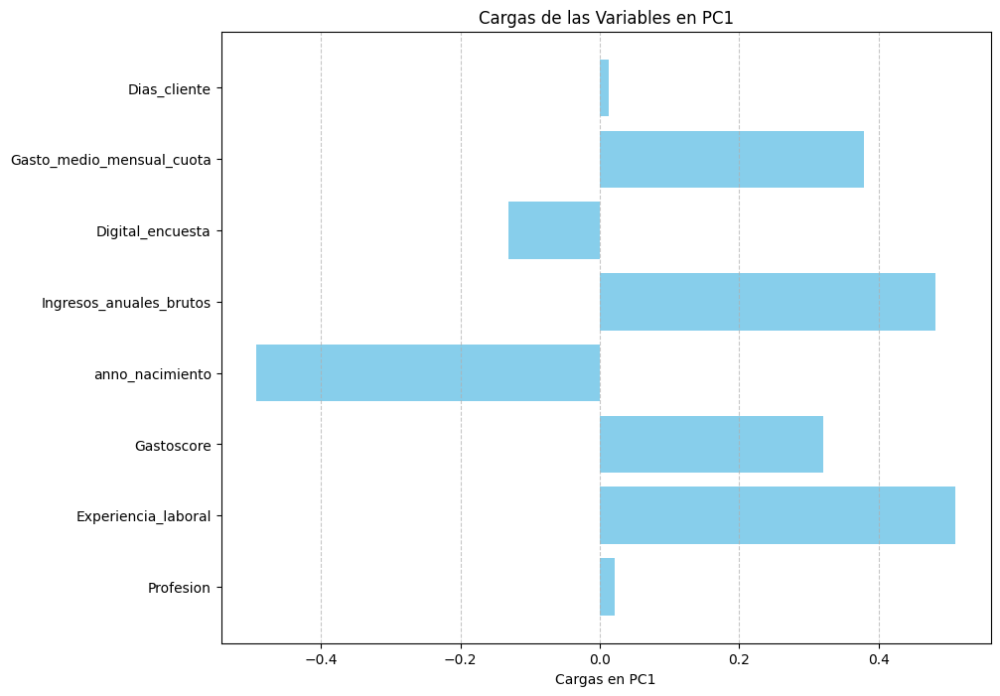

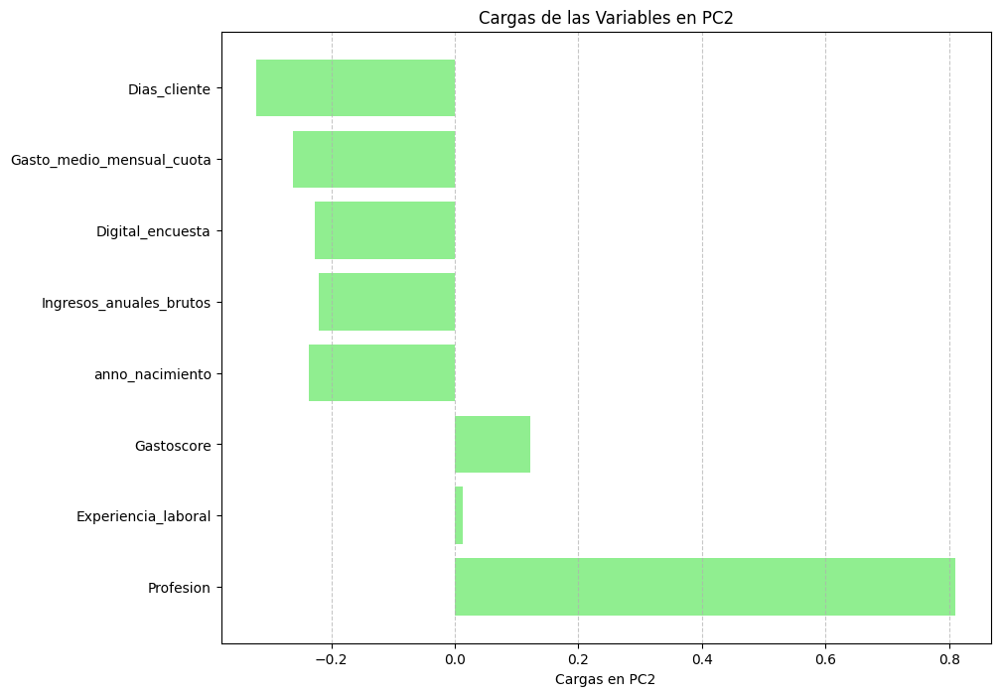

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


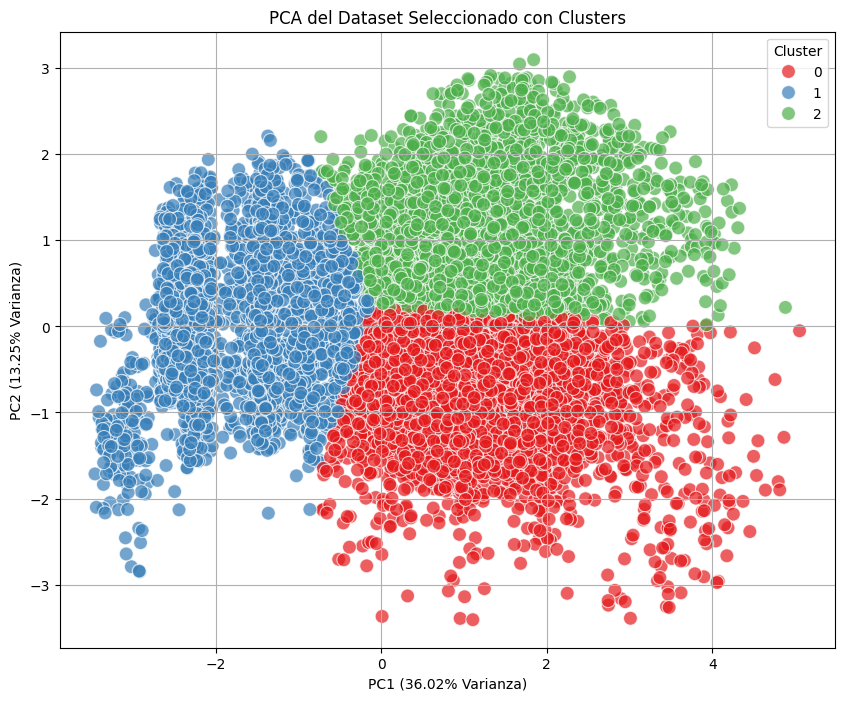

In [31]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

#### 3

In [32]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": False,
    "Profesion": True,
    "Experiencia_laboral": True,
    "Gastoscore": True,
    "Family_Size": False,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": True,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]


Variables continuas seleccionadas para PCA: ['Profesion', 'Experiencia_laboral', 'Gastoscore', 'anno_nacimiento', 'Ingresos_anuales_brutos', 'Digital_encuesta', 'Gasto_medio_mensual_cuota', 'Dias_cliente']

Datos estandarizados:
   Profesion  Experiencia_laboral  Gastoscore  anno_nacimiento  \
0   0.268026             0.775758   -0.731429        -1.034957   
1   0.623398             0.775758    0.621270        -0.872187   
2  -1.153465             0.775758    0.621270        -0.926444   
3  -0.087347            -0.470020   -0.731429         0.809766   
4   1.334144             0.775758    0.621270        -0.221108   

   Ingresos_anuales_brutos  Digital_encuesta  Gasto_medio_mensual_cuota  \
0                 1.052800         -0.099417                   1.210732   
1                 1.231385         -0.255354                   0.164441   
2                -0.545951          0.056052                  -0.533086   
3                -0.888343          0.004073                  -0.533086  

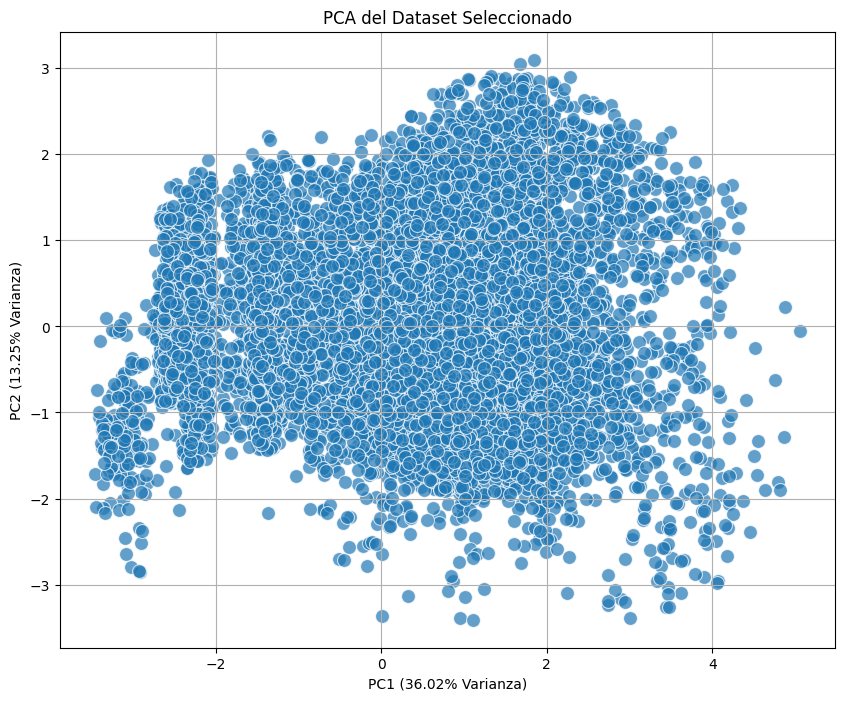

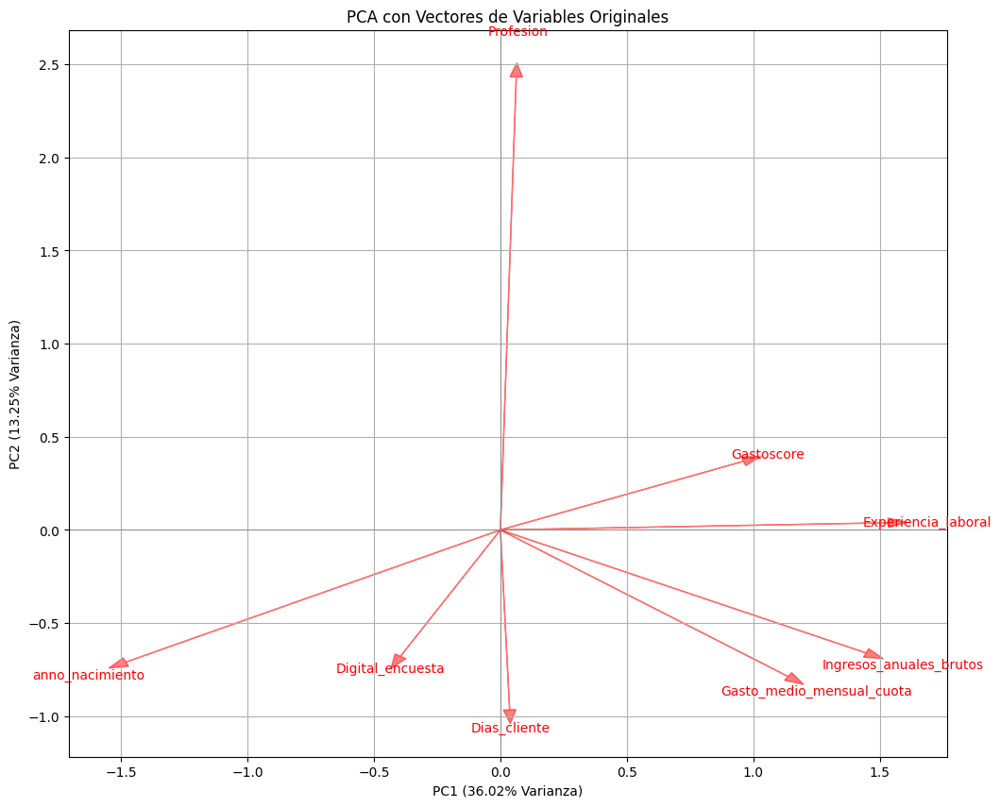


Cargas de las variables en las componentes principales:
                                PC1       PC2
Profesion                  0.020894  0.810636
Experiencia_laboral        0.510694  0.012913
Gastoscore                 0.320134  0.122869
anno_nacimiento           -0.493250 -0.236421
Ingresos_anuales_brutos    0.481605 -0.220015
Digital_encuesta          -0.131548 -0.226021
Gasto_medio_mensual_cuota  0.378916 -0.262155
Dias_cliente               0.012182 -0.321703


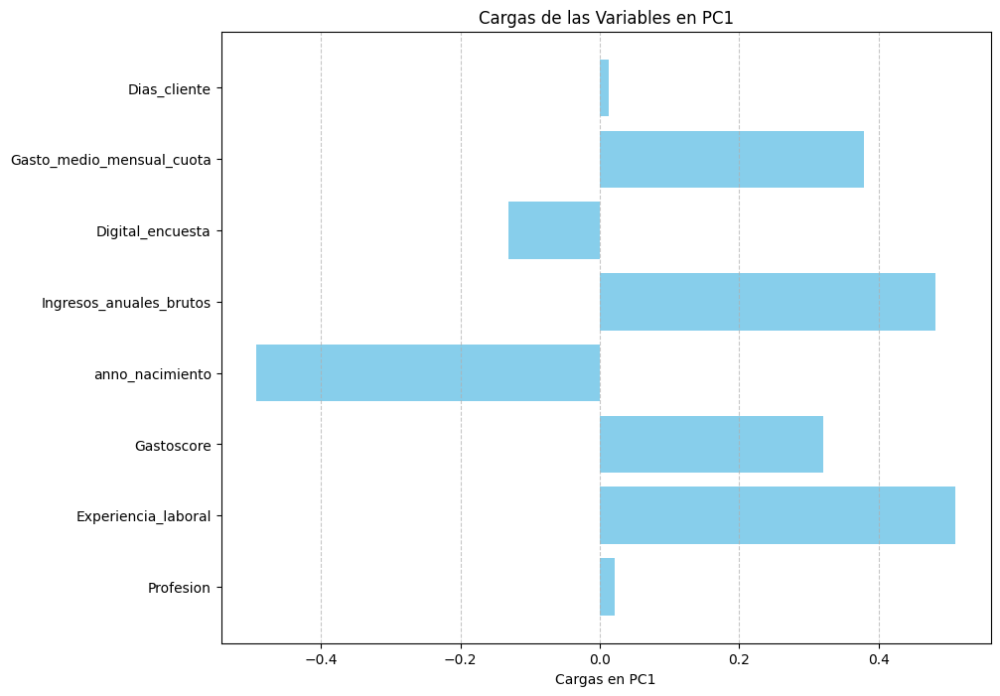

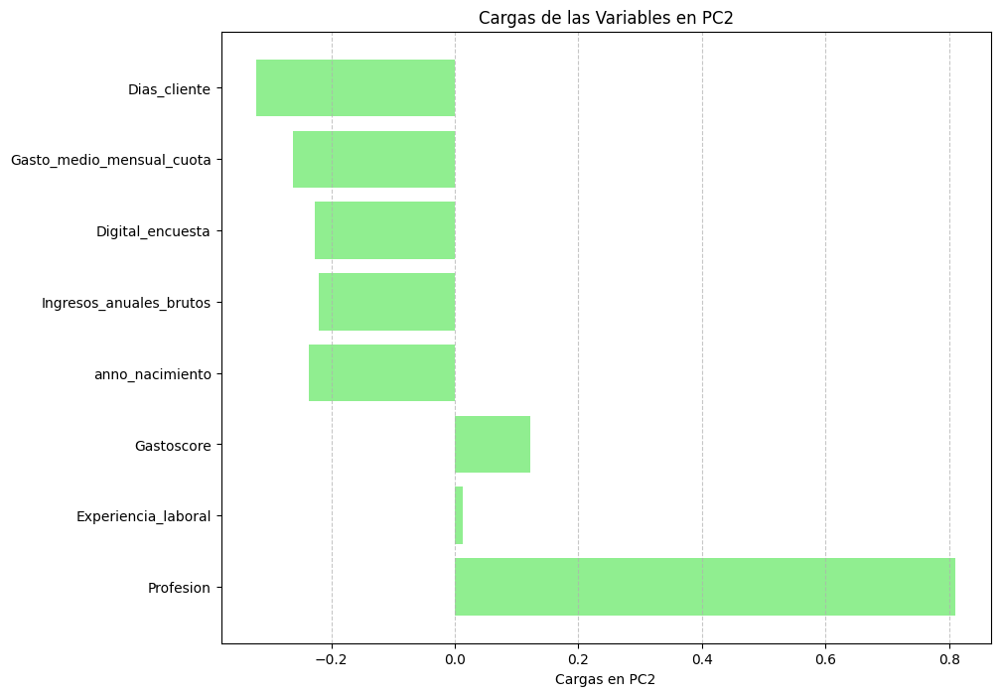

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


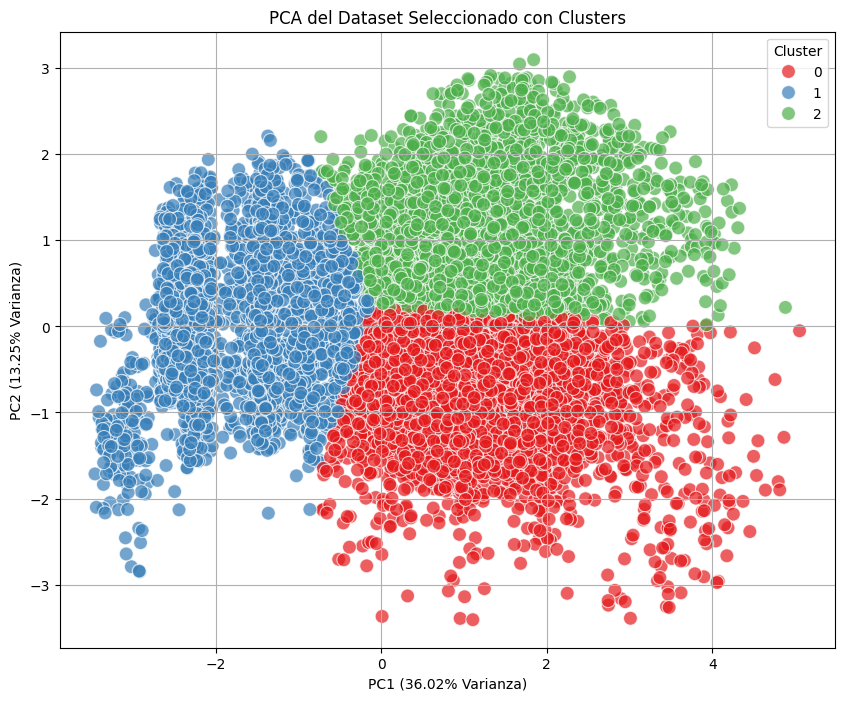

In [33]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

### 4

In [34]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": True,
    "Profesion": False,
    "Experiencia_laboral": True,
    "Gastoscore": False,
    "Family_Size": True,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": False,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]


Variables continuas seleccionadas para PCA: ['Experiencia_laboral', 'Family_Size', 'anno_nacimiento', 'Ingresos_anuales_brutos', 'Gasto_medio_mensual_cuota', 'Dias_cliente']

Datos estandarizados:
   Experiencia_laboral  Family_Size  anno_nacimiento  Ingresos_anuales_brutos  \
0             0.775758     0.152186        -1.034957                 1.052800   
1             0.775758    -0.493738        -0.872187                 1.231385   
2             0.775758     0.152186        -0.926444                -0.545951   
3            -0.470020     0.798110         0.809766                -0.888343   
4             0.775758    -0.493738        -0.221108                -0.741176   

   Gasto_medio_mensual_cuota  Dias_cliente  
0                   1.210732     -0.692072  
1                   0.164441      0.416520  
2                  -0.533086      0.732300  
3                  -0.533086      1.652767  
4                  -0.533086     -0.860041  
PC1: 45.48%
PC2: 16.68%


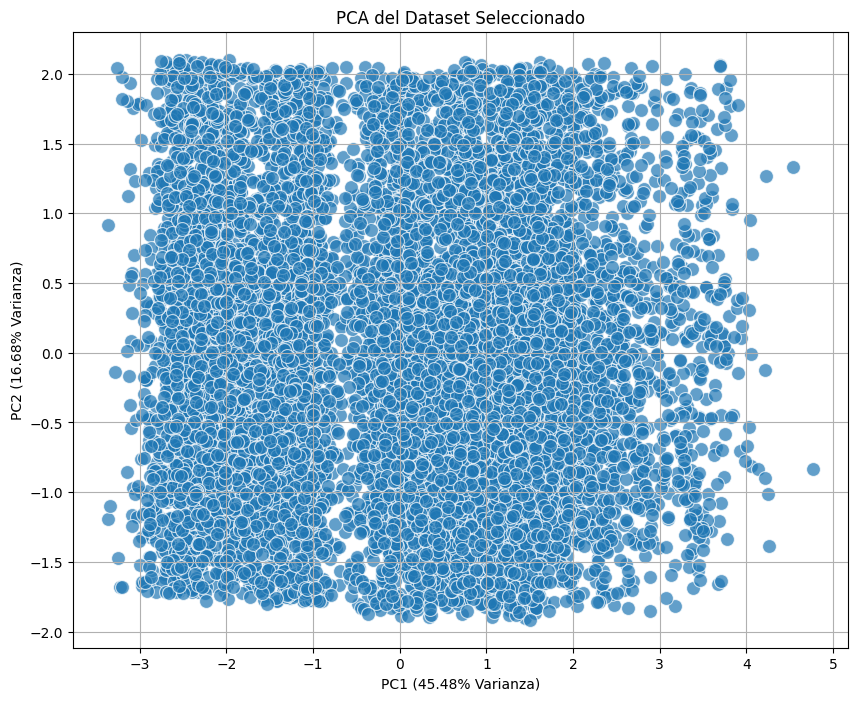

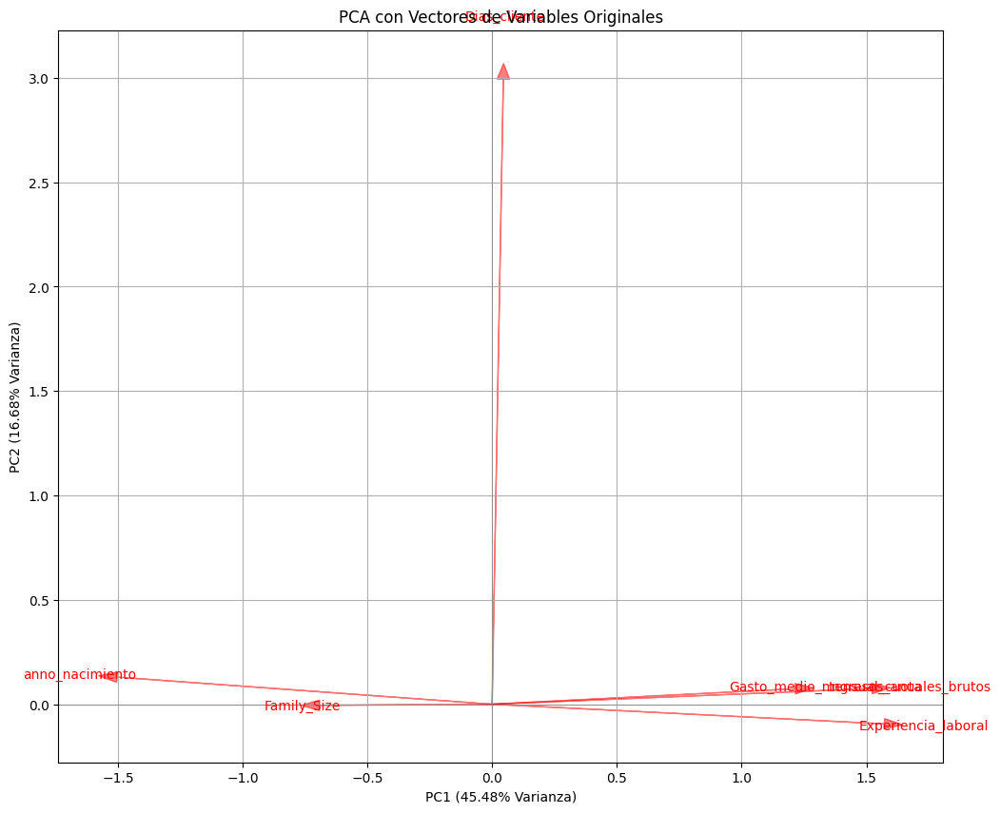


Cargas de las variables en las componentes principales:
                                PC1       PC2
Experiencia_laboral        0.523901 -0.031310
Family_Size               -0.230472 -0.001692
anno_nacimiento           -0.500906  0.043271
Ingresos_anuales_brutos    0.507338  0.025074
Gasto_medio_mensual_cuota  0.404830  0.024668
Dias_cliente               0.015011  0.997952


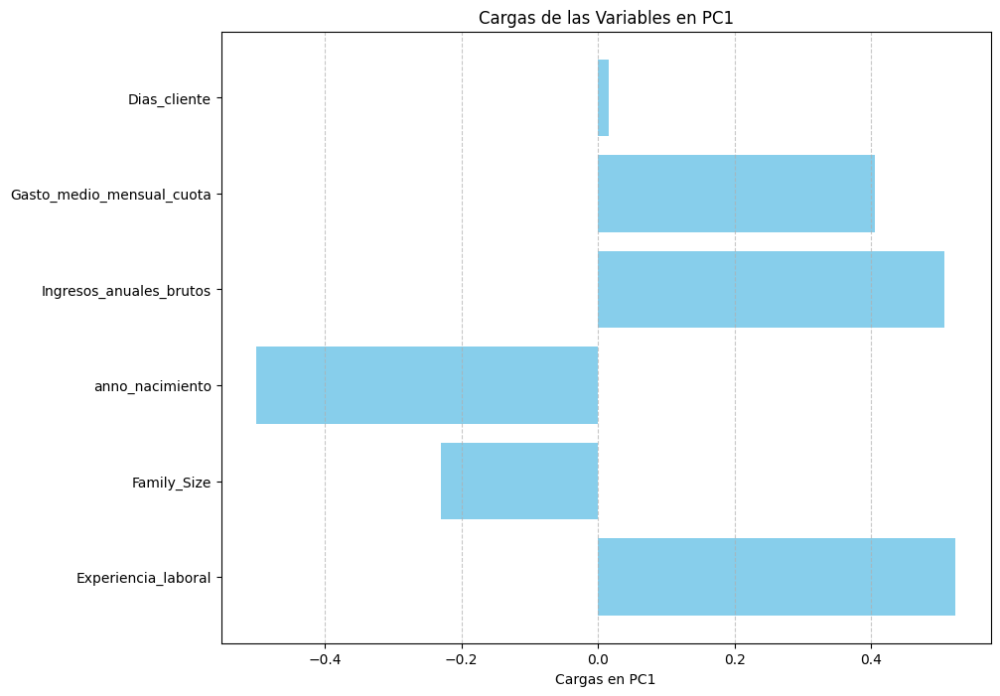

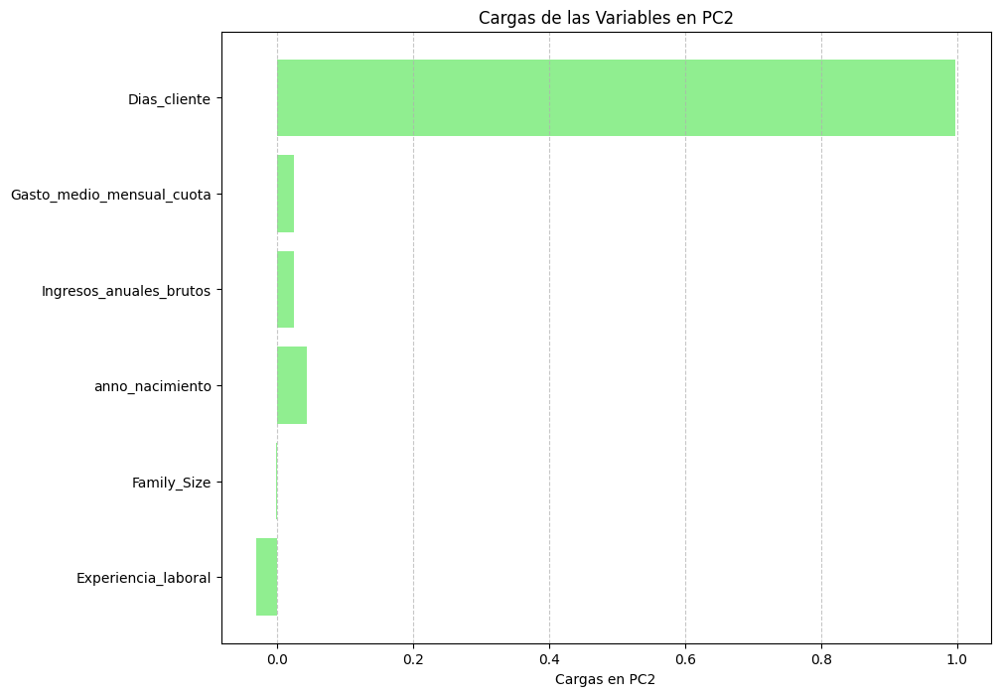

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


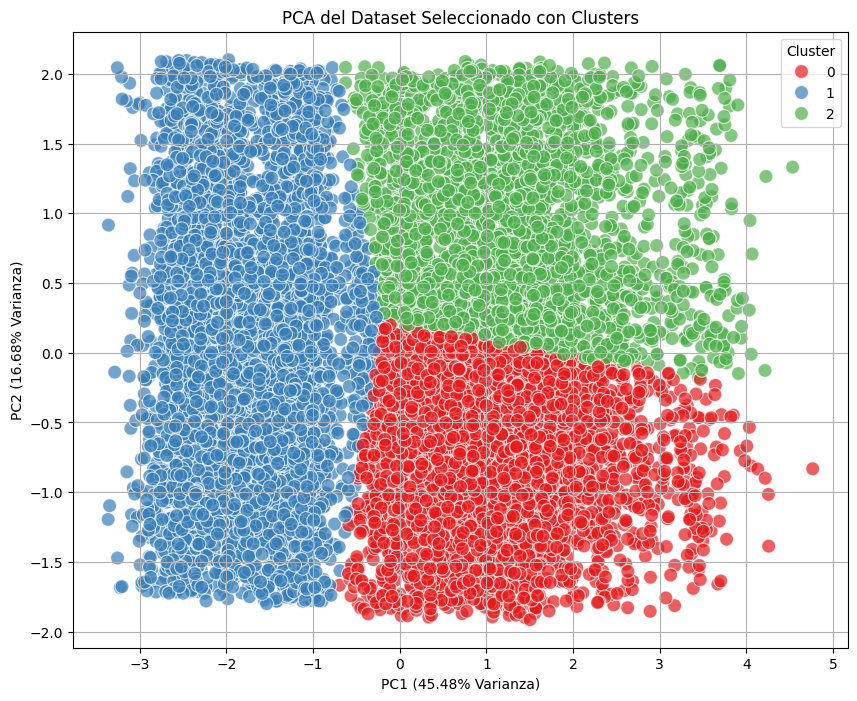

In [35]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

### 5

In [36]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": True,
    "Profesion": False,
    "Experiencia_laboral": True,
    "Gastoscore": False,
    "Family_Size": True,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": False,
    "Provincia": True,
    "Digital_encuesta": False,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]


Variables continuas seleccionadas para PCA: ['Experiencia_laboral', 'Family_Size', 'anno_nacimiento', 'Provincia', 'Gasto_medio_mensual_cuota', 'Dias_cliente']

Datos estandarizados:
   Experiencia_laboral  Family_Size  anno_nacimiento  Provincia  \
0             0.775758     0.152186        -1.034957   0.858601   
1             0.775758    -0.493738        -0.872187  -1.643249   
2             0.775758     0.152186        -0.926444   1.206080   
3            -0.470020     0.798110         0.809766  -0.044845   
4             0.775758    -0.493738        -0.221108   0.024651   

   Gasto_medio_mensual_cuota  Dias_cliente  
0                   1.210732     -0.692072  
1                   0.164441      0.416520  
2                  -0.533086      0.732300  
3                  -0.533086      1.652767  
4                  -0.533086     -0.860041  
PC1: 35.64%
PC2: 16.71%


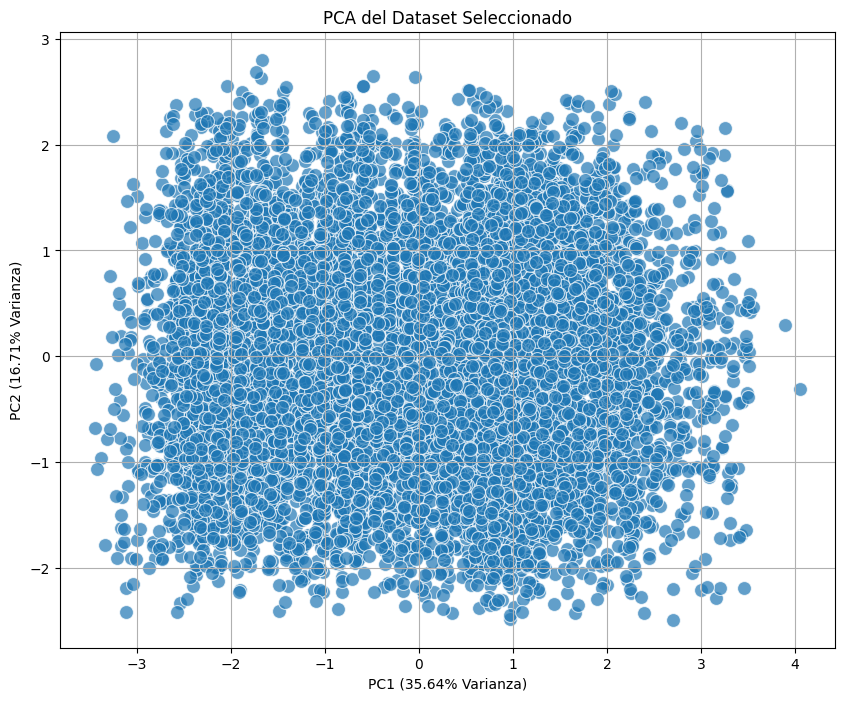

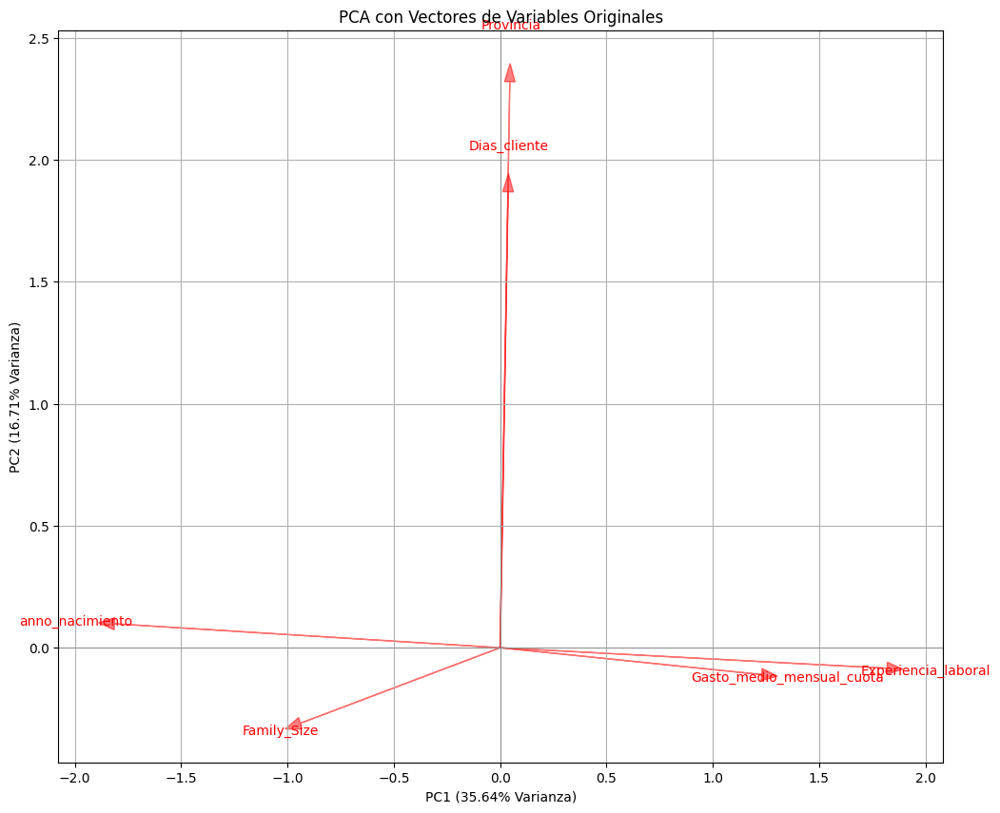


Cargas de las variables en las componentes principales:
                                PC1       PC2
Experiencia_laboral        0.606528 -0.028063
Family_Size               -0.313199 -0.103213
anno_nacimiento           -0.604683  0.032709
Provincia                  0.015140  0.773352
Gasto_medio_mensual_cuota  0.409882 -0.036633
Dias_cliente               0.012489  0.622956


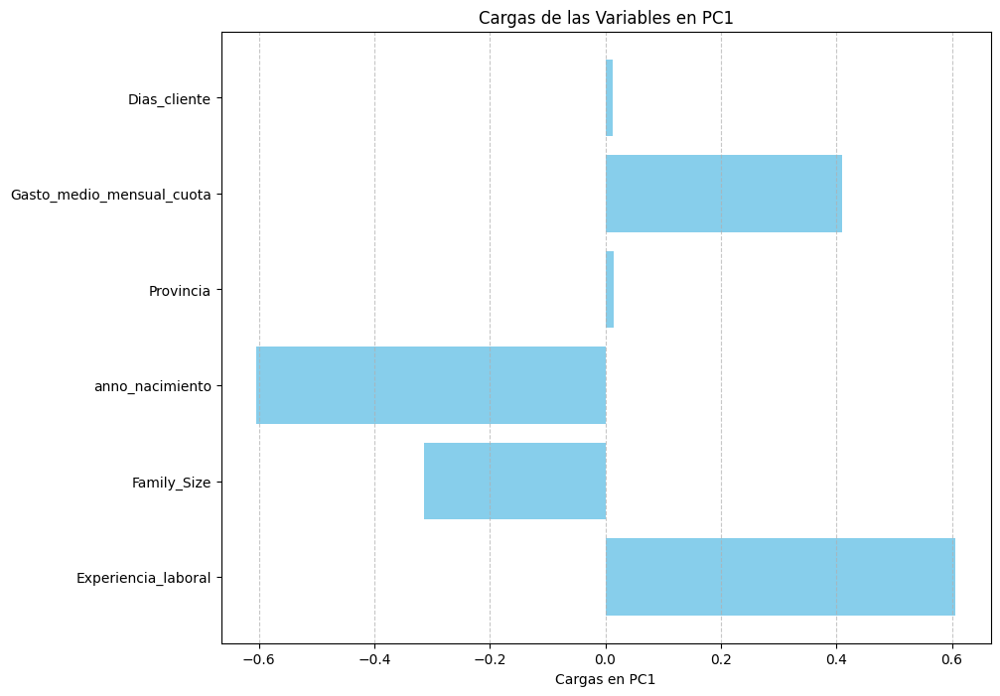

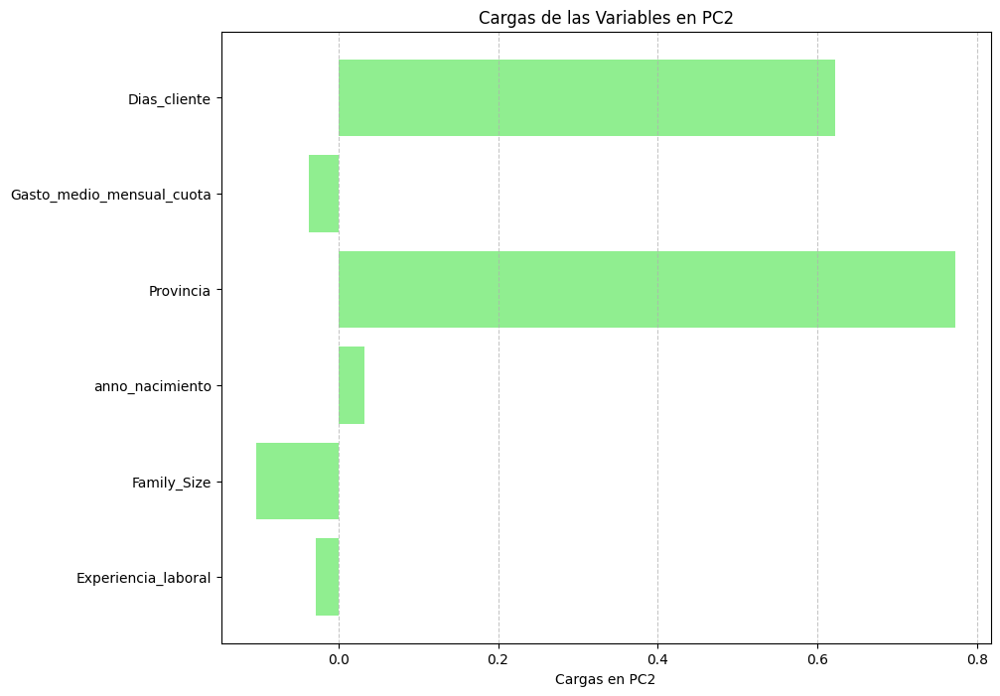

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


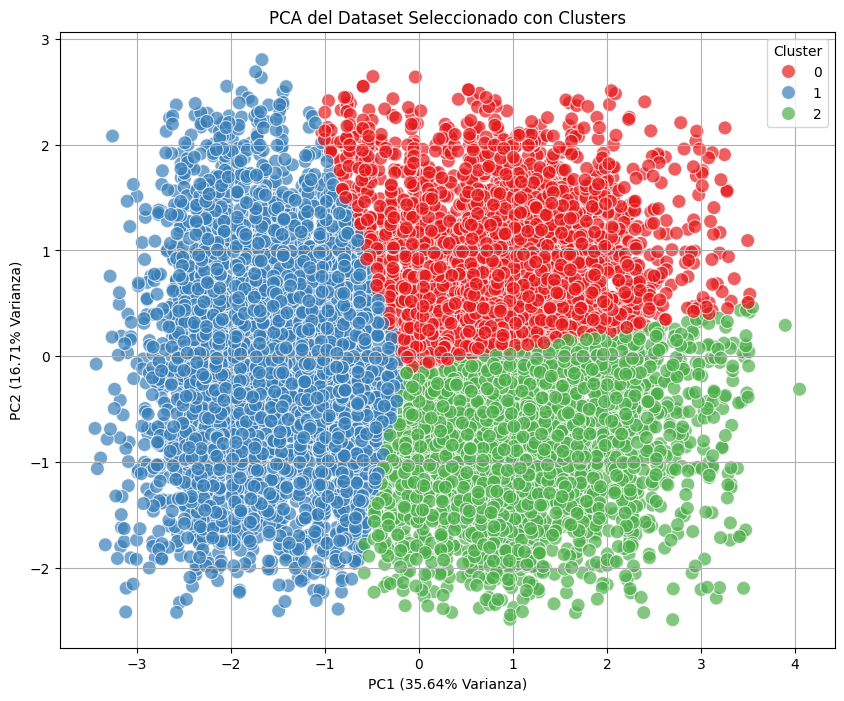

In [37]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

### 6

In [38]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": True,
    "Profesion": False,
    "Experiencia_laboral": True,
    "Gastoscore": False,
    "Family_Size": True,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": False,
    "Provincia": False,
    "Digital_encuesta": False,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]


Variables continuas seleccionadas para PCA: ['Experiencia_laboral', 'Family_Size', 'anno_nacimiento', 'Gasto_medio_mensual_cuota', 'Dias_cliente']

Datos estandarizados:
   Experiencia_laboral  Family_Size  anno_nacimiento  \
0             0.775758     0.152186        -1.034957   
1             0.775758    -0.493738        -0.872187   
2             0.775758     0.152186        -0.926444   
3            -0.470020     0.798110         0.809766   
4             0.775758    -0.493738        -0.221108   

   Gasto_medio_mensual_cuota  Dias_cliente  
0                   1.210732     -0.692072  
1                   0.164441      0.416520  
2                  -0.533086      0.732300  
3                  -0.533086      1.652767  
4                  -0.533086     -0.860041  
PC1: 42.76%
PC2: 20.01%


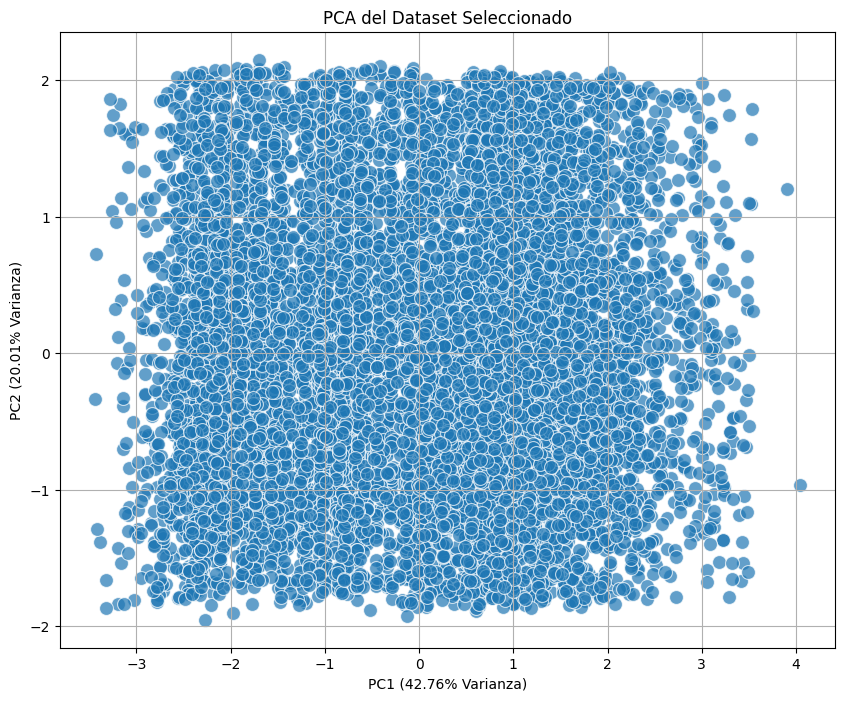

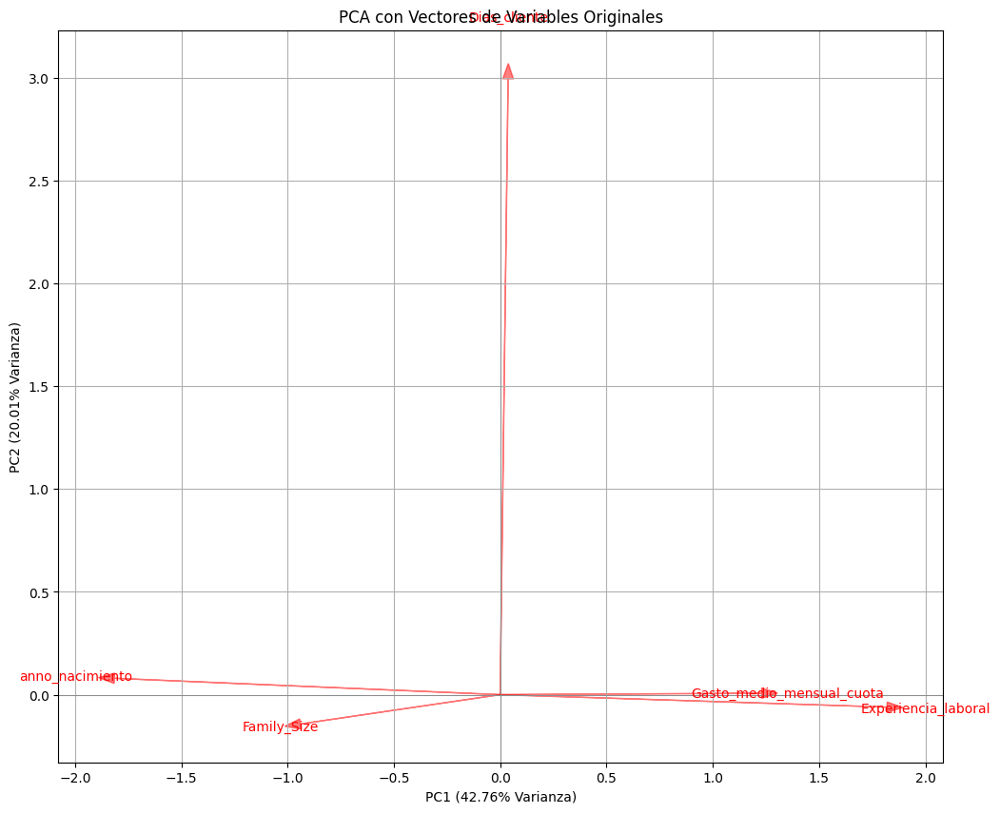


Cargas de las variables en las componentes principales:
                                PC1       PC2
Experiencia_laboral        0.606600 -0.020177
Family_Size               -0.313100 -0.047548
anno_nacimiento           -0.604786  0.026525
Gasto_medio_mensual_cuota  0.409979  0.002290
Dias_cliente               0.012476  0.998310


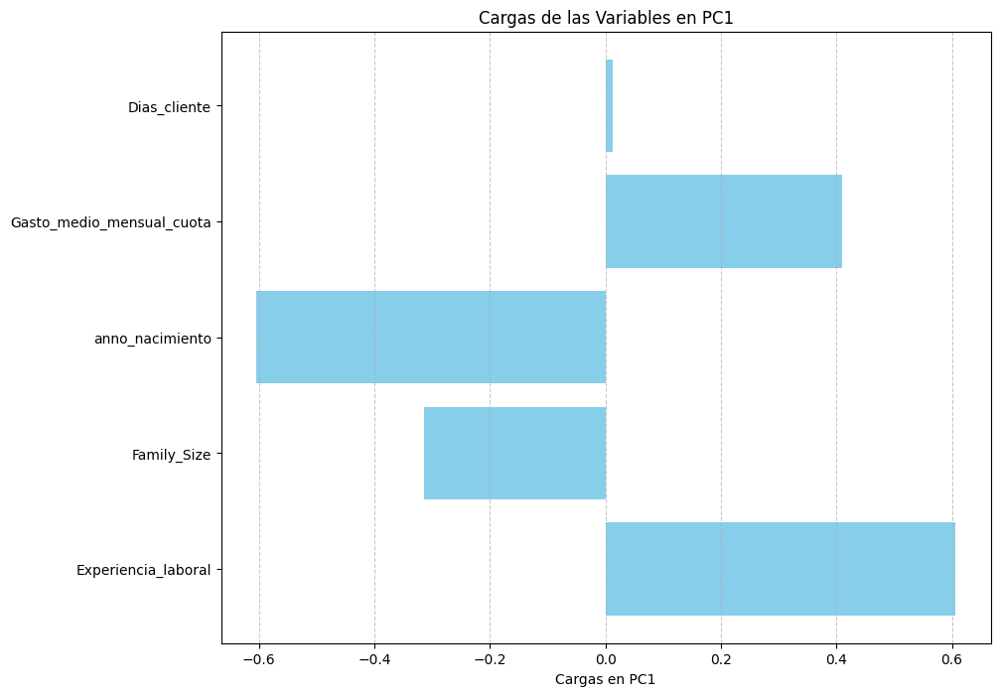

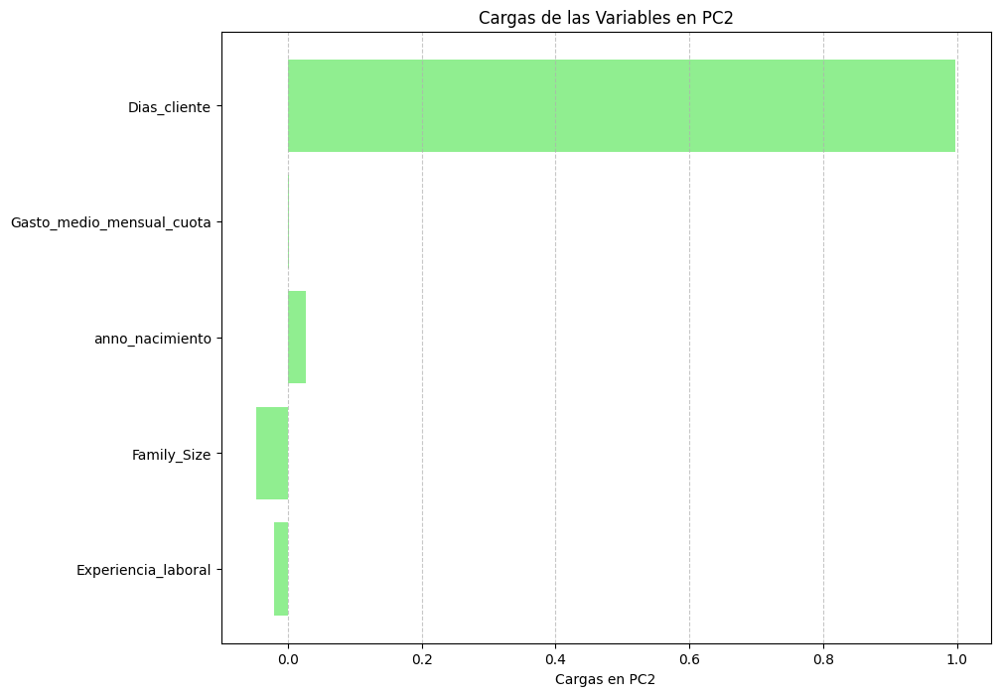

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


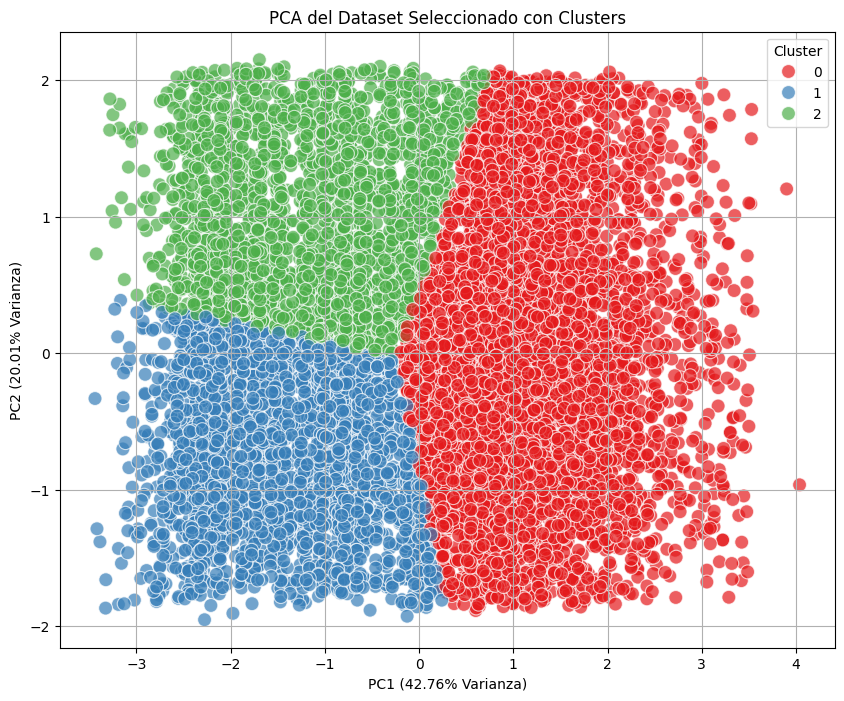

In [39]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

### 5 god crec

---
## REAL

In [40]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": True,
    "Profesion": False,
    "Experiencia_laboral": True,
    "Gastoscore": False,
    "Family_Size": True,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": False,
    "Provincia": False,
    "Digital_encuesta": False,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False,
    "Region": True
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]


Variables continuas seleccionadas para PCA: ['Experiencia_laboral', 'Family_Size', 'anno_nacimiento', 'Gasto_medio_mensual_cuota', 'Dias_cliente', 'Region']

Datos estandarizados:
   Experiencia_laboral  Family_Size  anno_nacimiento  \
0             0.775758     0.152186        -1.034957   
1             0.775758    -0.493738        -0.872187   
2             0.775758     0.152186        -0.926444   
3            -0.470020     0.798110         0.809766   
4             0.775758    -0.493738        -0.221108   

   Gasto_medio_mensual_cuota  Dias_cliente    Region  
0                   1.210732     -0.692072 -1.401689  
1                   0.164441      0.416520 -0.423065  
2                  -0.533086      0.732300 -1.401689  
3                  -0.533086      1.652767  0.555559  
4                  -0.533086     -0.860041 -0.423065  
PC1: 35.64%
PC2: 16.83%


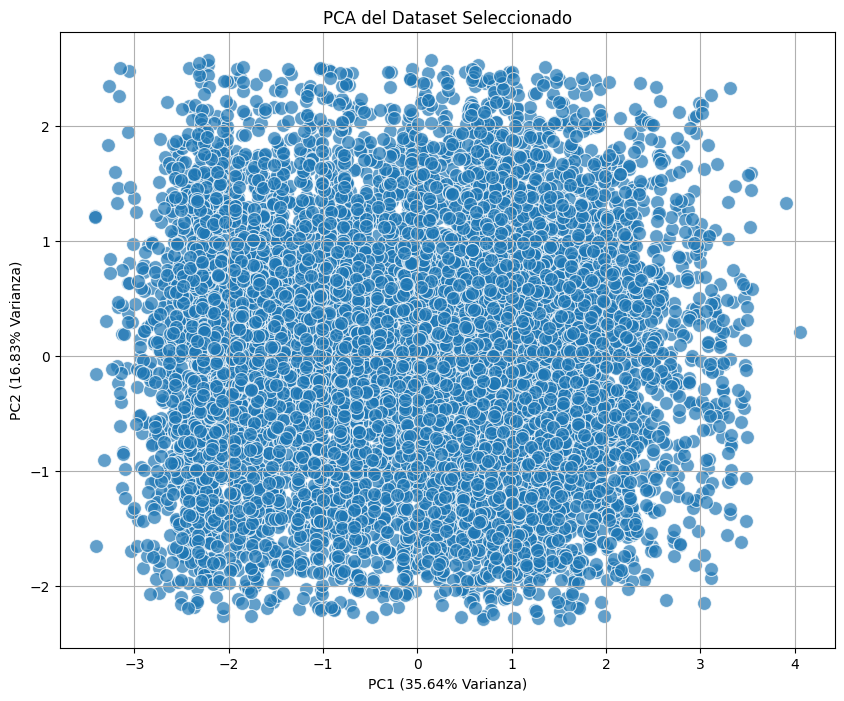

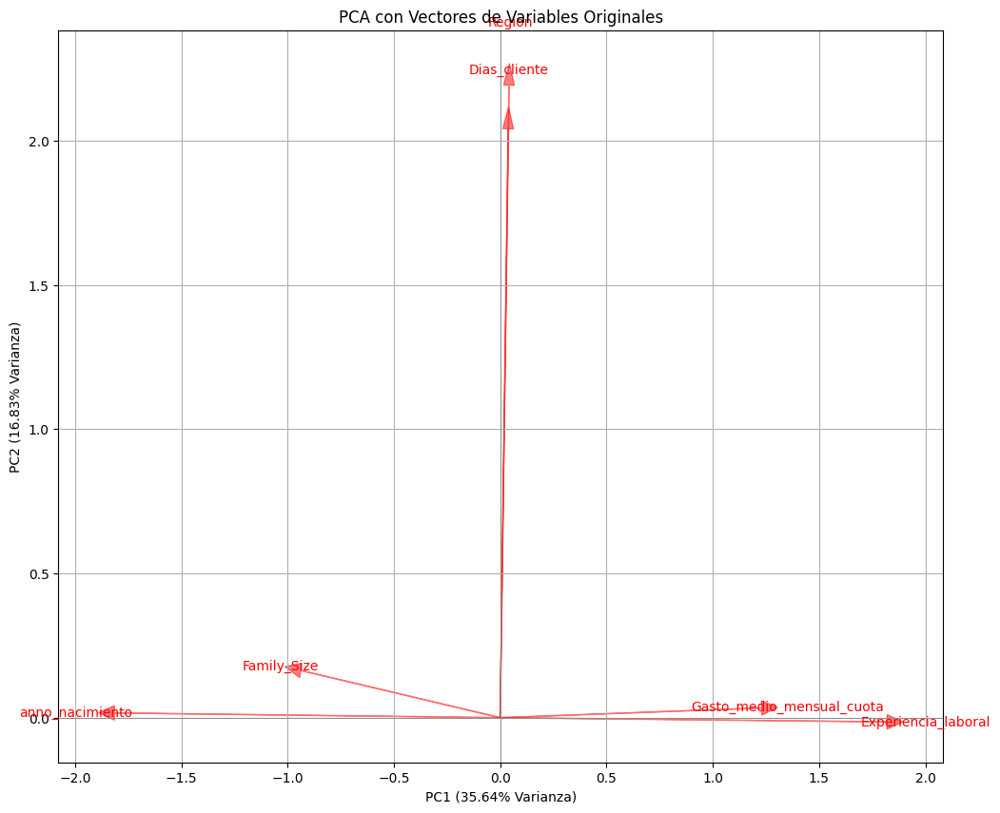


Cargas de las variables en las componentes principales:
                                PC1       PC2
Experiencia_laboral        0.606563 -0.004808
Family_Size               -0.312909  0.054607
anno_nacimiento           -0.604799  0.005485
Gasto_medio_mensual_cuota  0.409921  0.011227
Dias_cliente               0.012592  0.680296
Region                     0.013893  0.730778


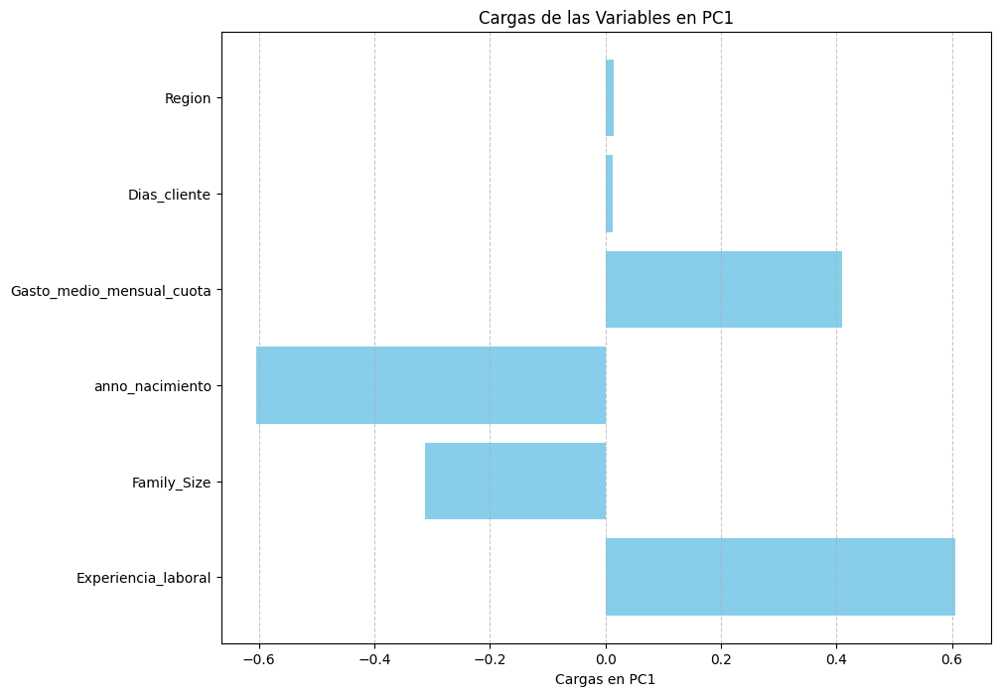

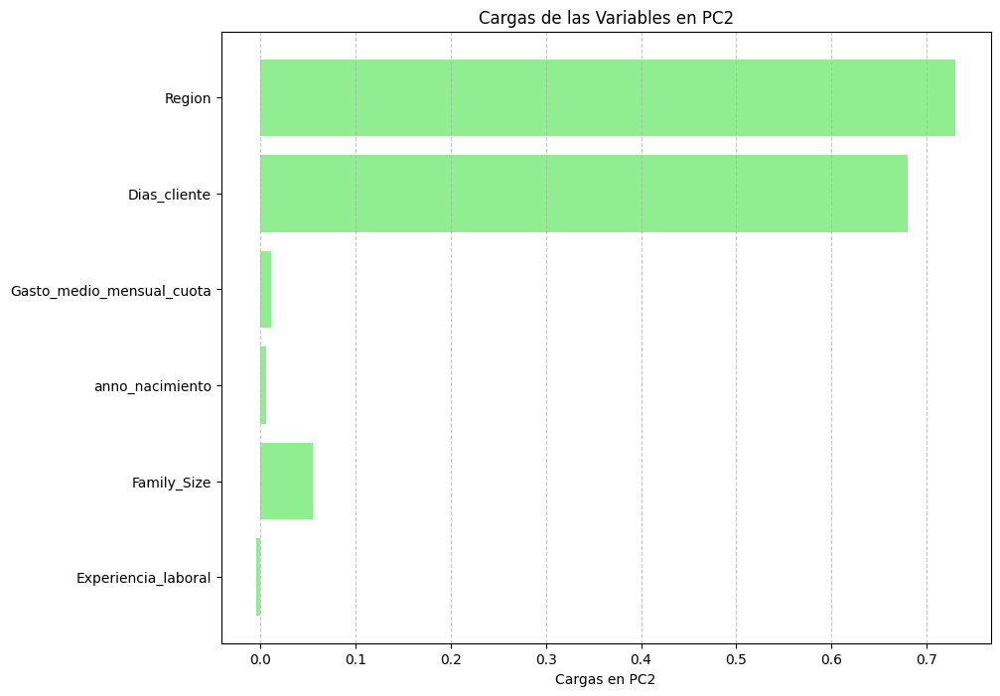

C:\Users\aleja\AppData\Local\Temp\ipykernel_19444\4073770015.py:118: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_selected.loc[:, 'Cluster'] = clusters


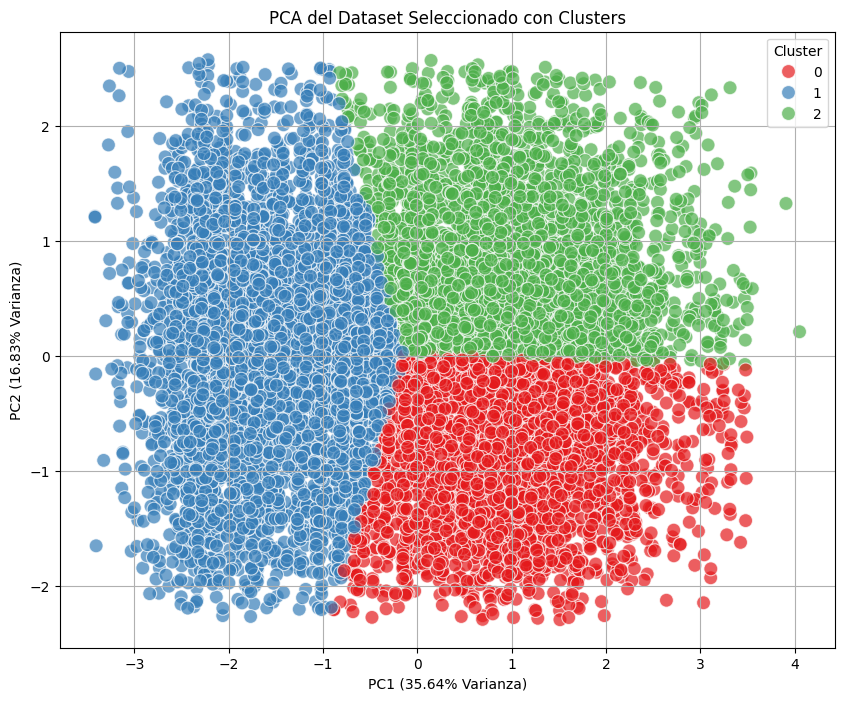

In [41]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=3, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

### Características

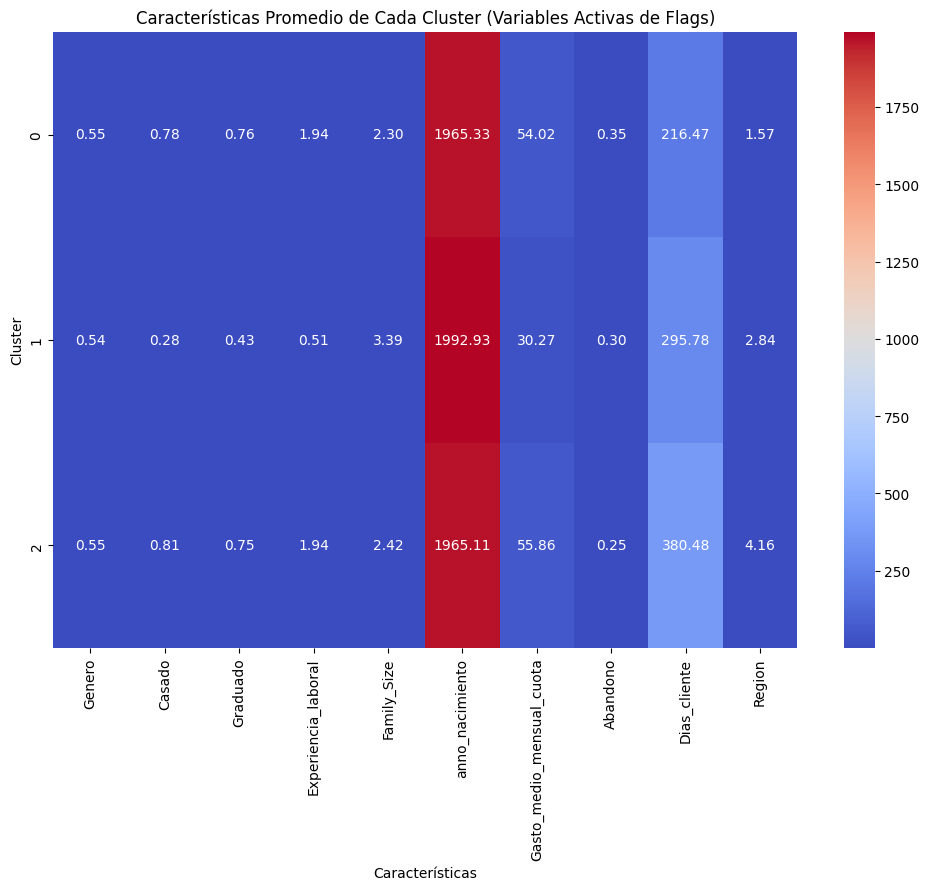

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filtrar las columnas que están activadas en 'flags'
columns_to_include = [col for col, flag in flags.items() if flag]

# Asegurarse de que estas columnas estén en el DataFrame
df_flags = df_selected[columns_to_include + ['Cluster']]

# Calcular la media de las variables para cada cluster
cluster_summary_flags = df_flags.groupby('Cluster').mean()

# Visualizar las características de cada cluster utilizando un heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(cluster_summary_flags, annot=True, cmap='coolwarm', fmt='.2f', cbar=True)
plt.title('Características Promedio de Cada Cluster (Variables Activas de Flags)')
plt.xlabel('Características')
plt.ylabel('Cluster')
plt.show()


## Amb 4 clusters:

In [53]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": True,
    "Profesion": True,
    "Experiencia_laboral": False,
    "Gastoscore": False,
    "Family_Size": False,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": False,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False,
    "Region": True
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]

#### 2

In [50]:
# Flags para activar o desactivar columnas específicas
flags = {
    "ID": False,
    "Genero": True,
    "Casado": True,
    "Edad": False,
    "Graduado": True,
    "Profesion": True,
    "Experiencia_laboral": True,
    "Gastoscore": False,
    "Family_Size": False,
    "anno_nacimiento": True,
    "Generacion": False,
    "Ingresos_anuales_brutos": True,
    "Provincia": False,
    "Digital_encuesta": False,
    "Gasto_medio_mensual_cuota": True,
    "Abandono": True,
    "Dias_cliente": True,
    "Campanna_anno": False,
    "Region": True
}

# Filtrar columnas basadas en las flags activas
selected_columns = [col for col, flag in flags.items() if flag]

# Seleccionar las columnas del DataFrame que corresponden a las flags activas
df_selected = df[selected_columns]

#### 3 tmb pa 4


Variables continuas seleccionadas para PCA: ['Profesion', 'anno_nacimiento', 'Ingresos_anuales_brutos', 'Gasto_medio_mensual_cuota', 'Dias_cliente', 'Region', 'Cluster']

Datos estandarizados:
   Profesion  anno_nacimiento  Ingresos_anuales_brutos  \
0   0.268026        -1.034957                 1.052800   
1   0.623398        -0.872187                 1.231385   
2  -1.153465        -0.926444                -0.545951   
3  -0.087347         0.809766                -0.888343   
4   1.334144        -0.221108                -0.741176   

   Gasto_medio_mensual_cuota  Dias_cliente    Region   Cluster  
0                   1.210732     -0.692072 -1.401689 -0.523953  
1                   0.164441      0.416520 -0.423065  1.333299  
2                  -0.533086      0.732300 -1.401689 -1.452579  
3                  -0.533086      1.652767  0.555559  0.404673  
4                  -0.533086     -0.860041 -0.423065  1.333299  
PC1: 31.90%
PC2: 22.24%


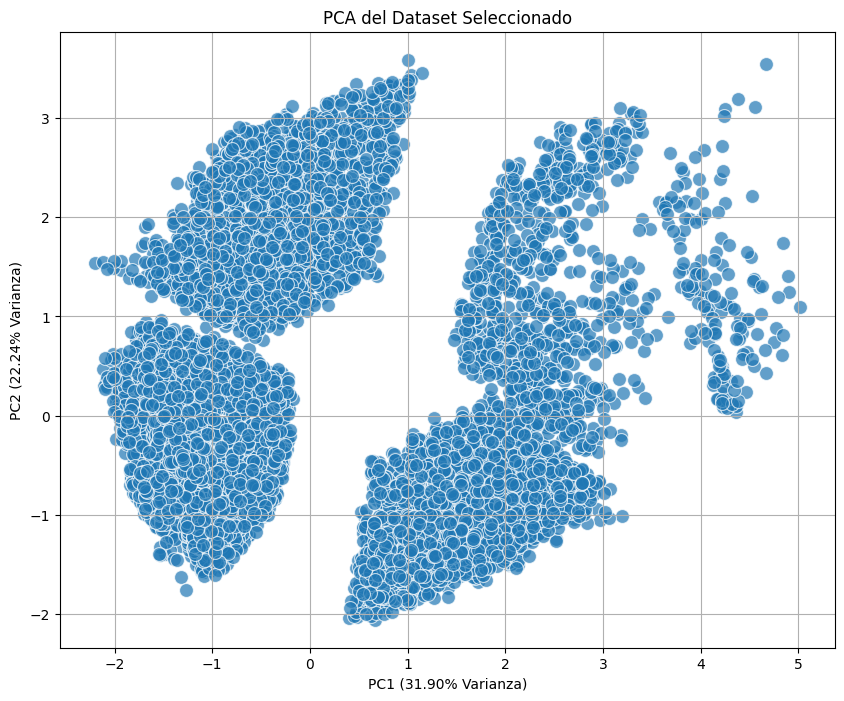

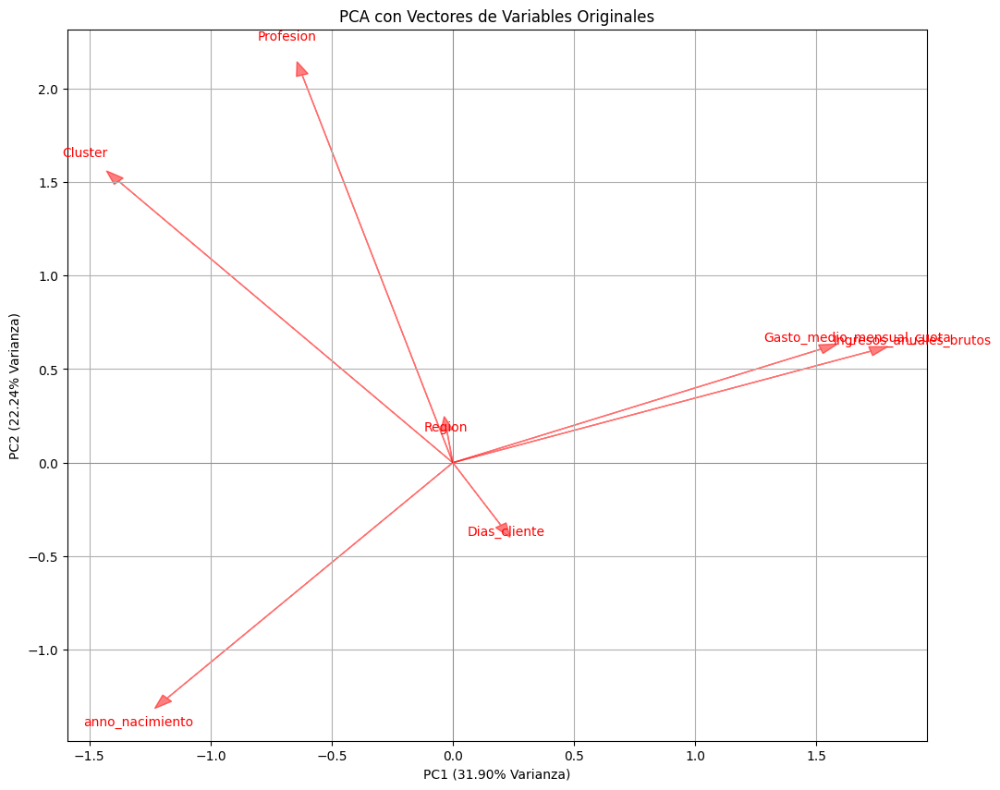


Cargas de las variables en las componentes principales:
                                PC1       PC2
Profesion                 -0.207247  0.690382
anno_nacimiento           -0.393098 -0.419504
Ingresos_anuales_brutos    0.574909  0.198566
Gasto_medio_mensual_cuota  0.506172  0.202187
Dias_cliente               0.066093 -0.111441
Region                    -0.008286  0.057643
Cluster                   -0.459734  0.501338


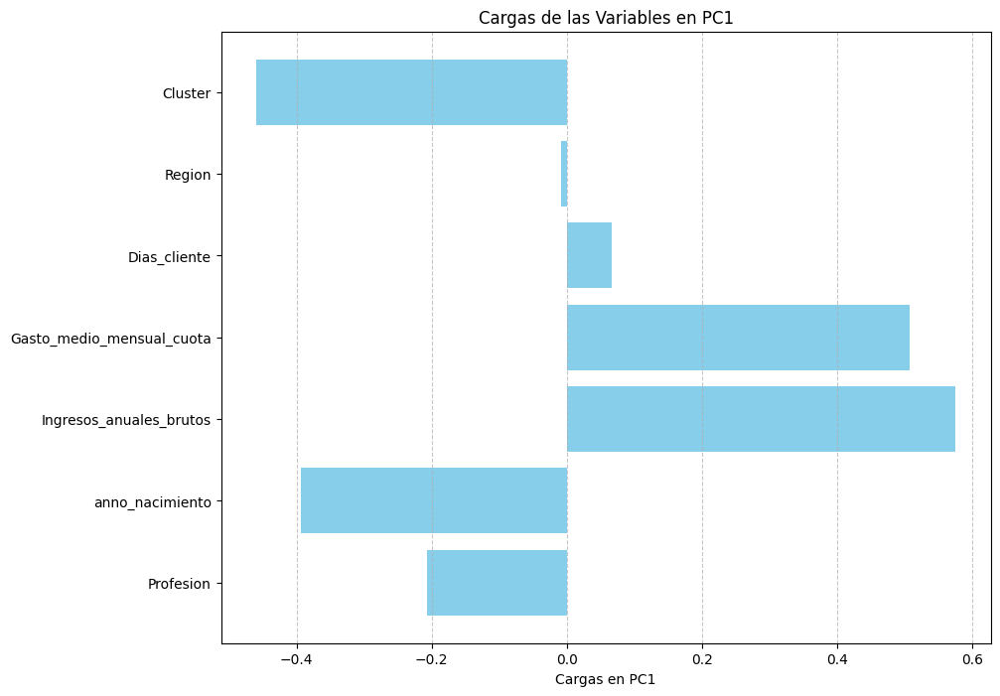

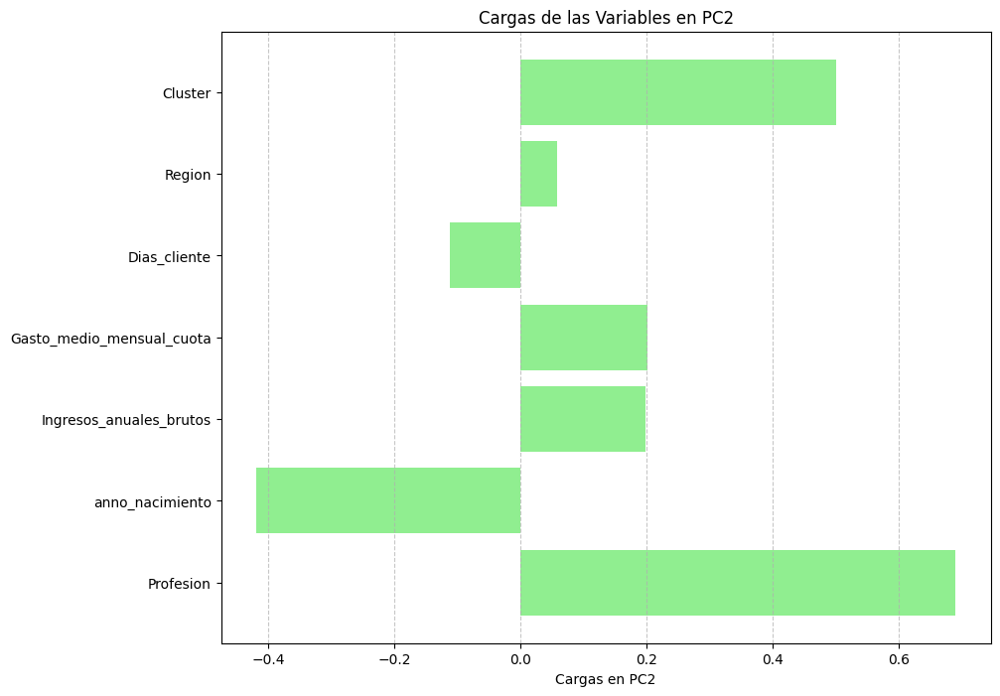

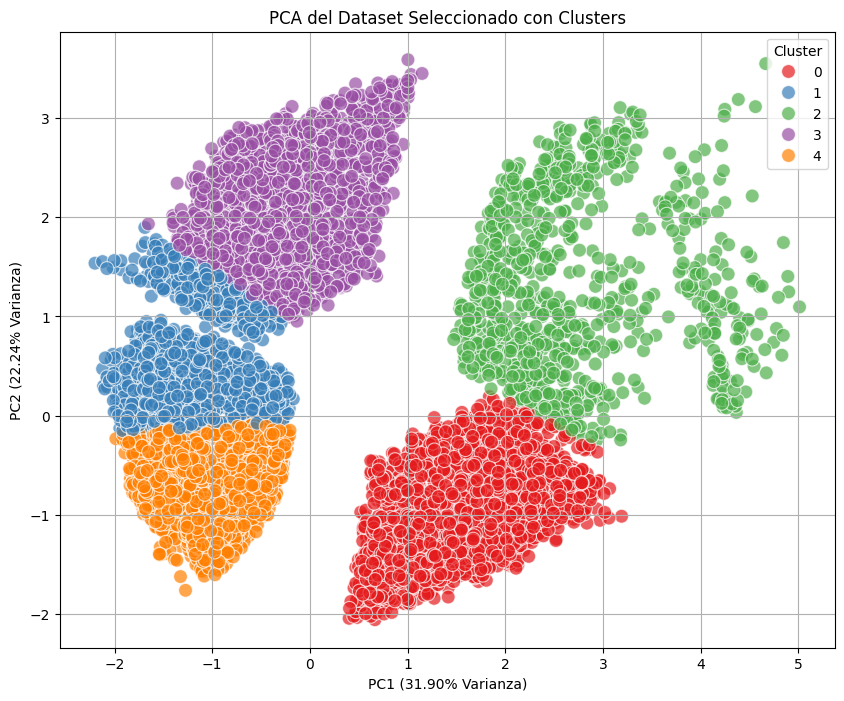

In [55]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Identificar variables numéricas
numerical_cols = df_selected.select_dtypes(include=[np.number]).columns.tolist()

# Identificar variables binarias y continuas
binary_cols = []
continuous_cols = []

for col in numerical_cols:
    unique_values = df_selected[col].dropna().unique()
    if sorted(unique_values) == [0, 1]:
        binary_cols.append(col)
    else:
        continuous_cols.append(col)

# Excluir 'ID' si está presente en las continuas
if 'ID' in continuous_cols:
    continuous_cols.remove('ID')

# Verificar las columnas seleccionadas para PCA
print("\nVariables continuas seleccionadas para PCA:", continuous_cols)

# Seleccionar solo variables numéricas continuas
df_continuous = df_selected[continuous_cols]

# Manejo de valores faltantes
df_cleaned = df_continuous.dropna()

# Verificar si df_cleaned está vacío antes de continuar
if df_cleaned.empty:
    raise ValueError("❌ Error: No hay suficientes datos después de eliminar valores faltantes. Prueba imputar valores en lugar de eliminarlos.")

# Estandarizar las variables numéricas
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_cleaned)

df_scaled = pd.DataFrame(X_scaled, columns=continuous_cols)
print("\nDatos estandarizados:")
print(df_scaled.head())

# Aplicar PCA
n_components = 2  # Puedes ajustar este número según necesidades
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)
pca_df = pd.DataFrame(data=principal_components, columns=[f'PC{i}' for i in range(1, n_components+1)])

# Varianza explicada
varianza_explicada = pca.explained_variance_ratio_
for i, var in enumerate(varianza_explicada, start=1):
    print(f"PC{i}: {var*100:.2f}%")

# Visualización: Scatter Plot
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', data=pca_df, s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()

# Visualización: Biplot
cargas = pca.components_.T
escalamiento = 3  # Ajusta este valor según los datos
cargas_scaled = cargas * escalamiento

plt.figure(figsize=(12,10))

for i, var in enumerate(continuous_cols):
    plt.arrow(0, 0, cargas_scaled[i,0], cargas_scaled[i,1], 
              color='r', alpha=0.5, head_width=0.05)
    plt.text(cargas_scaled[i,0]*1.1, cargas_scaled[i,1]*1.1, 
             var, color='r', ha='center', va='center')

plt.title('PCA con Vectores de Variables Originales')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.axhline(0, color='grey', linewidth=0.5)
plt.axvline(0, color='grey', linewidth=0.5)
plt.show()

# 📌 Definir cargas_df antes de los gráficos
cargas_df = pd.DataFrame(cargas, index=continuous_cols, columns=['PC1', 'PC2'])
print("\nCargas de las variables en las componentes principales:")
print(cargas_df)

# 📊 Gráfico de Cargas para PC1
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC1'], color='skyblue')
plt.xlabel('Cargas en PC1')
plt.title('Cargas de las Variables en PC1')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Gráfico de Cargas para PC2
plt.figure(figsize=(10,8))
plt.barh(cargas_df.index, cargas_df['PC2'], color='lightgreen')
plt.xlabel('Cargas en PC2')
plt.title('Cargas de las Variables en PC2')
plt.grid(True, axis='x', linestyle='--', alpha=0.7)
plt.show()

# 📊 Clustering con K-Means sobre PCA
kmeans = KMeans(n_clusters=5, random_state=42)  # Ahora usamos 3 clusters
clusters = kmeans.fit_predict(pca_df[['PC1', 'PC2']])

# Añadir clusters al DataFrame
pca_df['Cluster'] = clusters

# Añadir clusters al DataFrame original
df_selected.loc[:, 'Cluster'] = clusters

# 📊 Visualizar PCA con Clusters
plt.figure(figsize=(10,8))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_df, palette='Set1', s=100, alpha=0.7)
plt.title('PCA del Dataset Seleccionado con Clusters')
plt.xlabel(f'PC1 ({varianza_explicada[0]*100:.2f}% Varianza)')
plt.ylabel(f'PC2 ({varianza_explicada[1]*100:.2f}% Varianza)')
plt.grid(True)
plt.show()